<a href="https://colab.research.google.com/github/LavanyaSirisha/ACM-Amrita-2019-2020-Assignments/blob/master/FoDS_Project_2021_FINAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **ANALYSIS OF EDUCATION SYSTEM IN KARNATAKA THROUGH DATA SCIENCE**
19CSE304 FOUNDATIONS OF DATA SCIENCE




Lavanya Ratna Sirisha - BL.EN.U4CSE19076

Tanmayi Doddapaneni - BL.EN.U4CSE19035

Vinamratha Pattar - BL.EN.U4CSE19145

In [ ]:
from numpy import *
import numpy as np
import matplotlib.pyplot as mplot
import matplotlib.pylab as plt
import pandas as pd
import seaborn as sns 
import scipy.stats as stats
import pylab
import warnings
warnings.filterwarnings('ignore')
from sklearn.cluster import KMeans as km
from sklearn.linear_model import LinearRegression as LR
%matplotlib inline


# Reading and Cleaning of Data 

1. **Reading FDS STU FINAL.csv file which contains the District-wise data about students from different school management types and classes since 2012.**

In [ ]:
students=pd.read_csv('FDS STU FINAL.csv')
print(dict(students.isna().sum()))
print(students.shape)

{'Location': 0, 'Year': 0, 'Rural/Urban': 1, 'School Category': 0, 'School Management': 0, 'Pre_primary_girls': 0, 'Pre_primary_Boys': 0, 'Pre_primary_Total': 0, 'class_I_Girls': 0, 'class_I_Boys': 0, 'class_I_Total': 0, 'class_II_Girls': 0, 'class_II_Boys': 0, 'class_II_Total': 0, 'class_III_Girls': 0, 'class_III_Boys': 0, 'class_III_Total': 0, 'class_IV_Girls': 0, 'class_IV_Boys': 0, 'class_IV_Total': 0, 'class_V_Girls': 0, 'class_V_Boys': 0, 'class_V_Total': 0, 'class_VI_Girls': 0, 'class_VI_Boys': 0, 'class_VI_Total': 0, 'class_VII_Girls': 0, 'class_VII_Boys': 0, 'class_VII_Total': 0, 'class_VIII_Girls': 0, 'class_VIII_Boys': 0, 'class_VIII_Total': 0, 'class_IX_Girls': 0, 'class_IX_Boys': 0, 'class_IX_Total': 0, 'class_X_Girls': 0, 'class_X_Boys': 0, 'class_X_Total': 0, 'class_XI_Girls': 0, 'class_XI_Boys': 0, 'class_XI_Total': 0, 'class_XII_Girls': 0, 'class_XII_Boys': 0, 'class_XII_Total': 0, 'Primary(I-V)_Girls': 0, 'Primary(I-V)_Boys': 0, 'Primary(I-V)_Total': 0, 'UpperPrimary(

**Finding any missing values**

In [ ]:
a=list(students.columns)
for i in a:
    print(i)
    print(students[students[i].isna()].index.tolist())

Location
[]
Year
[]
Rural/Urban
[8364]
School Category
[]
School Management
[]
Pre_primary_girls
[]
Pre_primary_Boys
[]
Pre_primary_Total
[]
class_I_Girls
[]
class_I_Boys
[]
class_I_Total
[]
class_II_Girls
[]
class_II_Boys
[]
class_II_Total
[]
class_III_Girls
[]
class_III_Boys
[]
class_III_Total
[]
class_IV_Girls
[]
class_IV_Boys
[]
class_IV_Total
[]
class_V_Girls
[]
class_V_Boys
[]
class_V_Total
[]
class_VI_Girls
[]
class_VI_Boys
[]
class_VI_Total
[]
class_VII_Girls
[]
class_VII_Boys
[]
class_VII_Total
[]
class_VIII_Girls
[]
class_VIII_Boys
[]
class_VIII_Total
[]
class_IX_Girls
[]
class_IX_Boys
[]
class_IX_Total
[]
class_X_Girls
[]
class_X_Boys
[]
class_X_Total
[]
class_XI_Girls
[]
class_XI_Boys
[]
class_XI_Total
[]
class_XII_Girls
[]
class_XII_Boys
[]
class_XII_Total
[]
Primary(I-V)_Girls
[]
Primary(I-V)_Boys
[]
Primary(I-V)_Total
[]
UpperPrimary(VI-VIII)_Girls
[]
UpperPrimary(VI-VIII)_Boys
[]
UpperPrimary(VI-VIII)_Total
[]
Secondary(IX-X)_Girls
[]
Secondary(IX-X)_Boys
[]
Secondary(I

**Filling the missing values with appropriate values**

In [ ]:
students.fillna({'Rural/Urban':'Rural'}, inplace=True)
s=students.loc[students['Location']=='MYSURU']
q=s.loc[s['Year']=='2016-17']
r=q.loc[q['School Category']=='HSS (XI-XII)']
u=r.loc[r['School Management']=='Department of Education']
u


,Location,Year,Rural/Urban,School Category,School Management,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,class_I_Girls,class_I_Boys,class_I_Total,class_II_Girls,class_II_Boys,class_II_Total,class_III_Girls,class_III_Boys,class_III_Total,class_IV_Girls,class_IV_Boys,class_IV_Total,class_V_Girls,class_V_Boys,class_V_Total,class_VI_Girls,class_VI_Boys,class_VI_Total,class_VII_Girls,class_VII_Boys,class_VII_Total,class_VIII_Girls,class_VIII_Boys,class_VIII_Total,class_IX_Girls,class_IX_Boys,class_IX_Total,class_X_Girls,class_X_Boys,class_X_Total,class_XI_Girls,class_XI_Boys,class_XI_Total,class_XII_Girls,class_XII_Boys,class_XII_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total,TotalWithoutPre-Primary_Girls,TotalWithoutPre-Primary_Boys,TotalWithoutPre-Primary_Total,TotalWithPre-Primary_Girls,TotalWithPre-Primary_Boys,TotalWithPre-Primary_Total
8328,MYSURU,2016-17,Rural,HSS (XI-XII),Department of Education,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8329,MYSURU,2016-17,Urban,HSS (XI-XII),Department of Education,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8364,MYSURU,2016-17,Rural,HSS (XI-XII),Department of Education,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
students = students.astype({'TotalWithPre-Primary_Total': 'int64'},errors='ignore')
print(list(students.columns))

['Location', 'Year', 'Rural/Urban', 'School Category', 'School Management', 'Pre_primary_girls', 'Pre_primary_Boys', 'Pre_primary_Total', 'class_I_Girls', 'class_I_Boys', 'class_I_Total', 'class_II_Girls', 'class_II_Boys', 'class_II_Total', 'class_III_Girls', 'class_III_Boys', 'class_III_Total', 'class_IV_Girls', 'class_IV_Boys', 'class_IV_Total', 'class_V_Girls', 'class_V_Boys', 'class_V_Total', 'class_VI_Girls', 'class_VI_Boys', 'class_VI_Total', 'class_VII_Girls', 'class_VII_Boys', 'class_VII_Total', 'class_VIII_Girls', 'class_VIII_Boys', 'class_VIII_Total', 'class_IX_Girls', 'class_IX_Boys', 'class_IX_Total', 'class_X_Girls', 'class_X_Boys', 'class_X_Total', 'class_XI_Girls', 'class_XI_Boys', 'class_XI_Total', 'class_XII_Girls', 'class_XII_Boys', 'class_XII_Total', 'Primary(I-V)_Girls', 'Primary(I-V)_Boys', 'Primary(I-V)_Total', 'UpperPrimary(VI-VIII)_Girls', 'UpperPrimary(VI-VIII)_Boys', 'UpperPrimary(VI-VIII)_Total', 'Secondary(IX-X)_Girls', 'Secondary(IX-X)_Boys', 'Secondary(IX-

In [ ]:
students.shape

(11934, 62)

**Data grouped by 'Location' and 'School Management' columns**

In [ ]:
summed_district_wise=students.groupby(['Location','School Management'], as_index=False).agg(lambda x: sum(x)).drop(['Year','Rural/Urban','School Category'],axis=1)
summed_district_wise

,Location,School Management,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,class_I_Girls,class_I_Boys,class_I_Total,class_II_Girls,class_II_Boys,class_II_Total,class_III_Girls,class_III_Boys,class_III_Total,class_IV_Girls,class_IV_Boys,class_IV_Total,class_V_Girls,class_V_Boys,class_V_Total,class_VI_Girls,class_VI_Boys,class_VI_Total,class_VII_Girls,class_VII_Boys,class_VII_Total,class_VIII_Girls,class_VIII_Boys,class_VIII_Total,class_IX_Girls,class_IX_Boys,class_IX_Total,class_X_Girls,class_X_Boys,class_X_Total,class_XI_Girls,class_XI_Boys,class_XI_Total,class_XII_Girls,class_XII_Boys,class_XII_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total,TotalWithoutPre-Primary_Girls,TotalWithoutPre-Primary_Boys,TotalWithoutPre-Primary_Total,TotalWithPre-Primary_Girls,TotalWithPre-Primary_Boys,TotalWithPre-Primary_Total
0,BAGALKOT,Central Govt,0,0,0,96,119,215,97,114,211,98,112,210,84,126,210,96,119,215,245,337,582,228,379,607,231,370,601,225,375,600,247,358,605,54,86,140,33,52,85,471,590,1061,704,1086,1790,472,733,1205,87,138,225,1734,2547,4281,1734,2547,4281
1,BAGALKOT,Department of Education,218,213,431,101852,89679,191531,104185,92310,196495,105191,93880,199071,106184,95229,201413,106740,97293,204033,103586,95684,199270,103990,96896,200886,74806,70659,145465,52821,52321,105142,45506,43074,88580,17175,12740,29915,13168,9242,22410,524152,468391,992543,282382,263239,545621,98327,95395,193722,30343,21982,52325,935204,849007,1784211,935422,849220,1784642
2,BAGALKOT,Government Aided,1967,2610,4577,16099,20254,36353,16076,20297,36373,16231,20536,36767,16222,20722,36944,16458,20930,37388,16016,21149,37165,15870,21325,37195,29317,36428,65745,34775,44199,78974,31899,40735,72634,13901,21014,34915,12752,18713,31465,81086,102739,183825,61203,78902,140105,66674,84934,151608,26653,39727,66380,235616,306302,541918,237583,308912,546495
3,BAGALKOT,Jawahar Navodaya Vidyalaya,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,27,54,81,35,59,94,35,56,91,29,50,79,30,49,79,0,0,0,0,0,0,0,0,0,97,169,266,59,99,158,0,0,0,156,268,424,156,268,424
4,BAGALKOT,Jawahar Navodaya Vidyalaya,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,27,44,71,60,96,156,59,101,160,61,100,161,63,97,160,17,24,41,23,8,31,0,0,0,146,241,387,124,197,321,40,32,72,310,470,780,310,470,780
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
408,YADAGIRI,Other Govt. managed schools,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,407,428,835,318,343,661,136,216,352,38,111,149,31,72,103,0,0,0,0,0,0,0,0,0,861,987,1848,69,183,252,0,0,0,930,1170,2100,930,1170,2100
409,YADAGIRI,Private Unaided (Recognized),7989,12243,20232,27487,42976,70463,24255,38601,62856,21539,34047,55586,18470,29714,48184,16407,25729,42136,12629,19555,32184,10823,17029,27852,7894,12581,20475,7334,11735,19069,6042,10173,16215,4123,6103,10226,3450,5305,8755,108158,171067,279225,31346,49165,80511,13376,21908,35284,7573,11408,18981,160453,253548,414001,168442,265791,434233
410,YADAGIRI,Social welfare Department,0,0,0,14,13,27,12,14,26,13,6,19,8,12,20,15,1,16,1532,1143,2675,1334,1066,2400,1086,999,2085,875,846,1721,751,780,1531,114,53,167,46,28,74,62,46,108,3952,3208,7160,1626,1626,3252,160,81,241,5800,4961,10761,5800,4961,10761
411,YADAGIRI,Tribal Welfare Department,0,0,0,85,39,124,111,31,142,104,40,144,119,22,141,112,23,135,1917,1754,3671,1866,1919,3785,1856,1795,3651,1656,1658,3314,1193,1365,2558,12,27,39,17,22,39,531,155,686,5639,5468,11107,2849,3023,5872,29,49,78,9048,8695,17743,9048,8695,17743


In [ ]:
summed_district_wise['School Management'].unique()

array(['Central Govt', 'Department of Education', 'Government Aided',
       'Jawahar Navodaya Vidyalaya', 'Jawahar Navodaya Vidyalaya ',
       'Kendriya Vidyalaya / Central School',
       'Other Govt. managed schools', 'Private Unaided (Recognized)',
       'Social welfare Department', 'Tribal Welfare Department',
       'Unrecognized', 'Local body', 'No response', 'Sainik School',
       'Madarsa unrecognized',
       'Madarsa recognized (by Wakf board/Madarsa Board)',
       'Madarsa recognized (by Wakf board/Madarsa Board) ',
       'Central Tibetan School', 'Railway School', 'Ministry of Labor',
       'Other Central Govt. Schools'], dtype=object)

**Total no: of districts**

In [ ]:
list_of_districts=list(students['Location'].unique())
print(len(list_of_districts))

34


# OBJECTIVE 1 - Analyzing the district-wise distribution of school categories to find the most successful one in terms of student enrollment.

In [ ]:
students["Rural/Urban"].replace({' Rural':'Rural'},inplace = True)
students["School Category"].replace({'PS (I-V) ': 'PS (I-V)'}, inplace=True)
students["School Management"].replace({'Madarsa recognized (by Wakf board/Madarsa Board) ': 'Madarsa recognized (by Wakf board/Madarsa Board)','Jawahar Navodaya Vidyalaya ' : 'Jawahar Navodaya Vidyalaya'}, inplace=True)
cols = list(students.columns)
for c in cols:
    print(students[c].unique(),len(students[c].unique()))

['BAGALKOT' 'BALLARI' 'BELAGAVI' 'BELAGAVI CHIKKODI' 'BENGALURU RURAL'
 'BENGALURU U NORTH' 'BENGALURU U SOUTH' 'BIDAR' 'CHAMARAJANAGARA'
 'CHIKKABALLAPURA' 'CHIKKAMANGALURU' 'CHITRADURGA' 'DAKSHINA KANNADA'
 'DAVANAGERE' 'DHARWAD' 'GADAG' 'HASSAN' 'HAVERI' 'KALABURGI' 'KODAGU'
 'KOLAR' 'KOPPAL' 'MANDYA' 'MYSURU' 'RAICHUR' 'RAMANAGARA' 'TUMAKURU'
 'TUMAKURU MADHUGIRI' 'UDUPI' 'UTTARA KANNADA' 'UTTARA KANNADA SIRSI'
 'VIJAYAPURA' 'YADAGIRI' 'SHIVAMOGGA'] 34
['2019-20' '2018-19' '2017-18' '2016-17' '2015-16' '2014-15' '2013-14'
 '2012-13'] 8
['Rural' 'Urban'] 2
['PS (I-V)' 'UPS (I-VIII)' 'UPS (VI-VIII)' 'SS (VI-X)' 'HSS (IX-XII)'
 'HSS (XI-XII)' 'HSS (VI-XII)' 'SS (I-X)' 'SS (IX-X)' 'HSS (I-XII)'] 10
['Tribal Welfare Department' 'Government Aided'
 'Private Unaided (Recognized)' 'Kendriya Vidyalaya / Central School'
 'Department of Education' 'Jawahar Navodaya Vidyalaya'
 'Other Govt. managed schools' 'Social welfare Department' 'Central Govt'
 'Unrecognized' 'Local body' 'Sainik School'

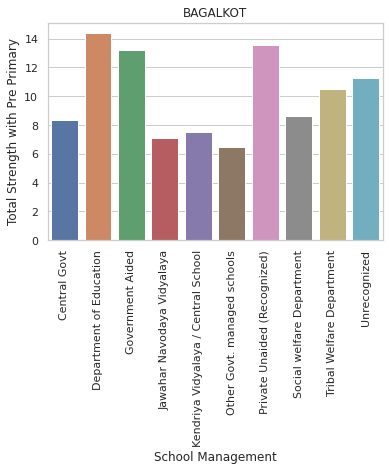

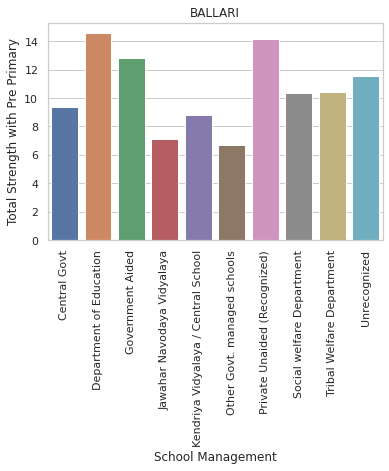

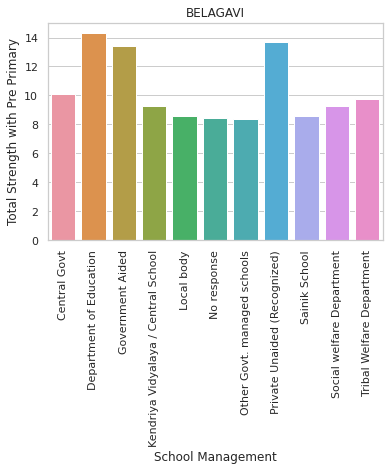

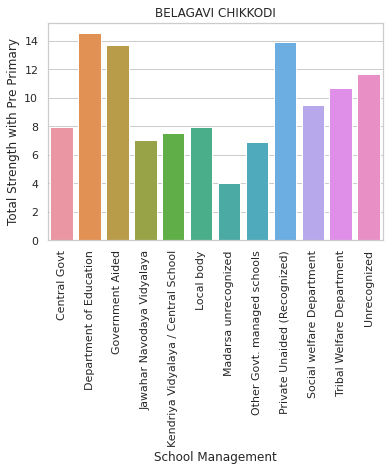

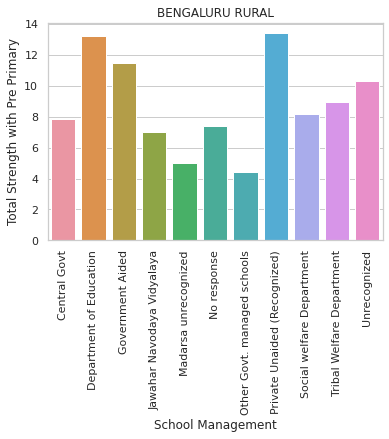

...

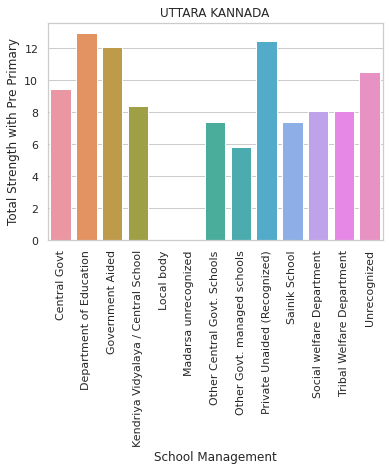

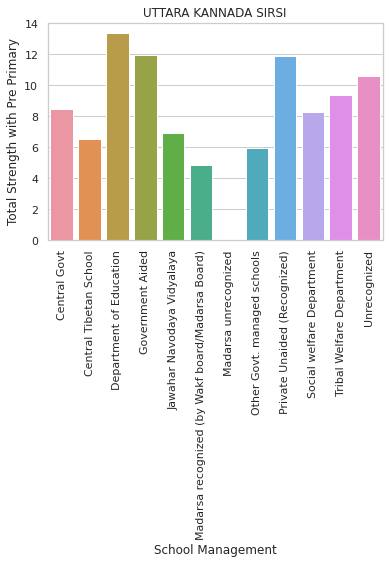

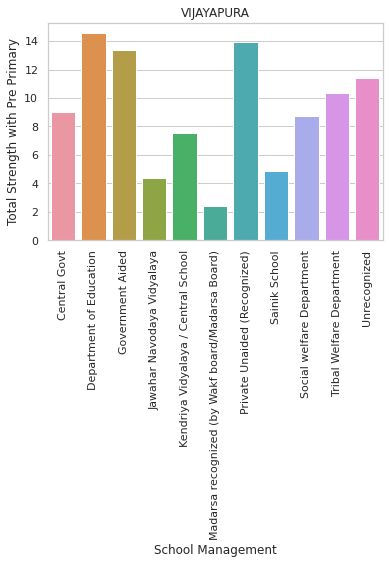

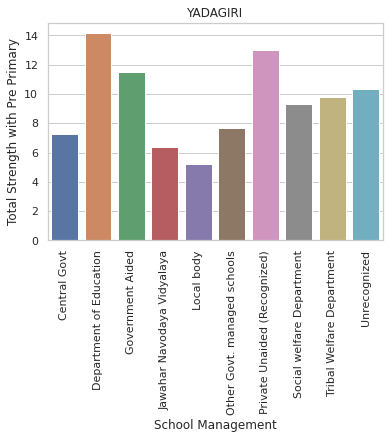

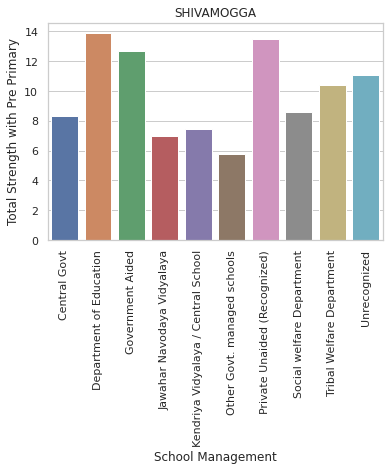

34


In [ ]:
list_of_districts=list(students['Location'].unique())
sns.set_theme(style="whitegrid")
count=0
out=[]
district_school_management = students.groupby(['Location','School Management'], as_index=False).agg(lambda x: sum(x)).drop(['Year','Rural/Urban','School Category'],axis=1)
district_school_management['tlogp']=np.log1p(district_school_management['TotalWithPre-Primary_Total'])
for district in list_of_districts:
    ax=sns.barplot(x="School Management",y="tlogp", data=district_school_management.loc[district_school_management['Location']==district])
    plt.ylabel("Total Strength with Pre Primary")
    plt.title(district)
    plt.xticks(rotation = 90)
    plt.show()
    count+=1
print(count)

# OBJECTIVE 2 -  Analyzing Boys vs Girls education rate.

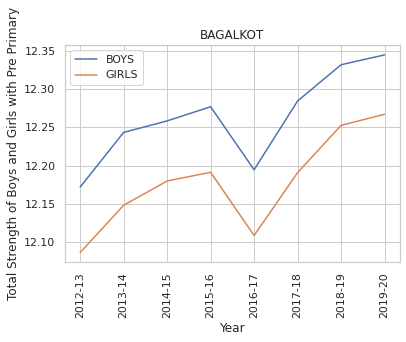

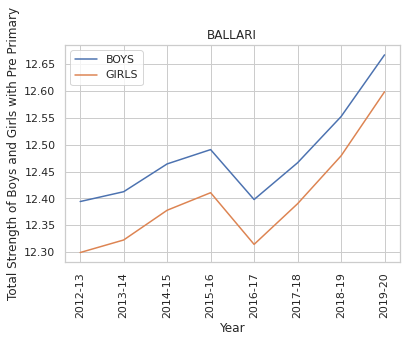

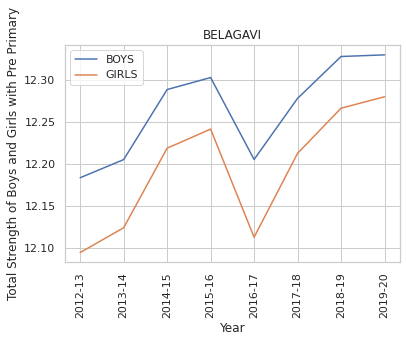

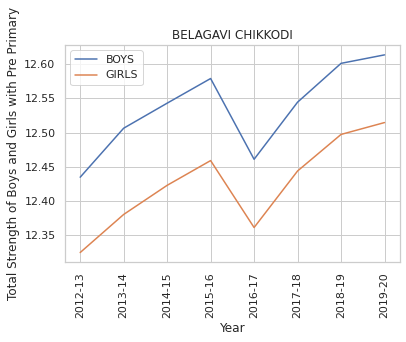

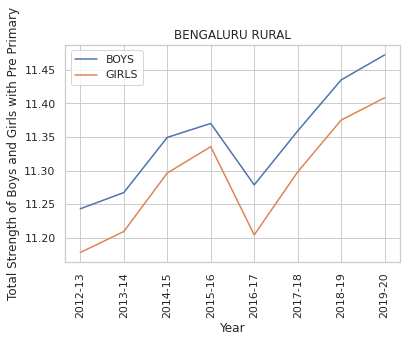

...

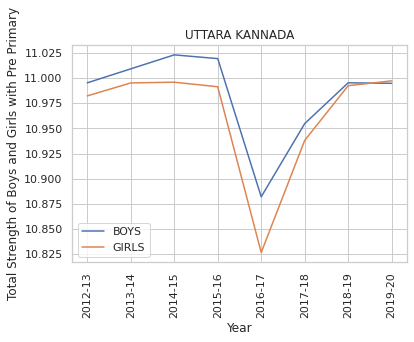

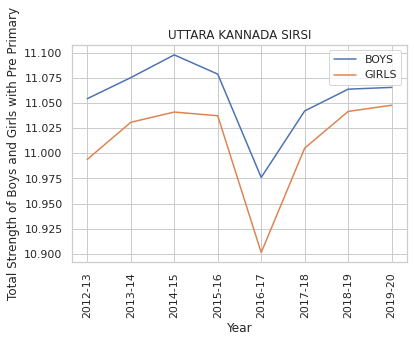

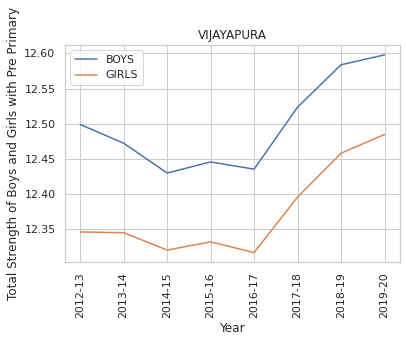

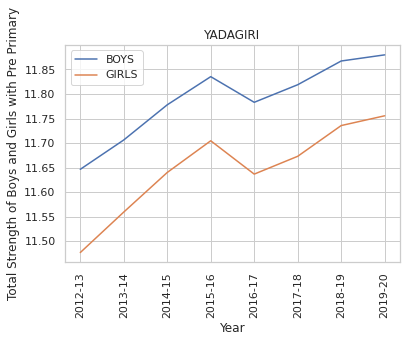

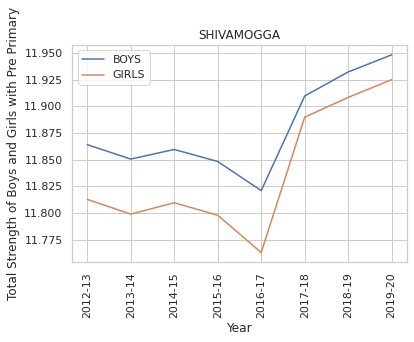

34


In [ ]:
list_of_districts=list(students['Location'].unique())
sns.set_theme(style="whitegrid")
count=0
summed_district_wise=students.groupby(['Location','Year'], as_index=False).agg(lambda x: sum(x)).drop(['Rural/Urban','School Category','School Management'],axis = 1)
summed_district_wise['tblogp']=np.log1p(summed_district_wise['TotalWithPre-Primary_Boys'])
summed_district_wise['tglogp']=np.log1p(summed_district_wise['TotalWithPre-Primary_Girls'])

for district in list_of_districts:
    data = summed_district_wise.loc[summed_district_wise['Location']==district]
    sns.lineplot(x = "Year", y = "tblogp",data = data, label = 'BOYS')
    sns.lineplot(x = "Year",y = "tglogp", data = data, label = 'GIRLS')
    plt.title(district)
    plt.ylabel('Total Strength of Boys and Girls with Pre Primary')
    plt.xticks(rotation = 90)
    plt.show()
    count+=1
print(count)

**Willingness factor analysis for boys vs. girl education rate**

In [ ]:
pop = pd.read_csv('TOTAL STRENGTH.csv')

In [ ]:
pop['total'] = pop['3-5'] + pop['6-10'] + pop['11-13'] + pop['14-15'] + pop['16-17']

In [ ]:
pop.isna().sum()

Name      0
Year      0
Gender    0
3-5       0
6-10      0
11-13     0
14-15     0
16-17     0
total     0
dtype: int64

In [ ]:
stud_pop = students.groupby(['Year'], as_index=False).agg(lambda x: sum(x)).drop(['Location','Rural/Urban','School Category','School Management'],axis=1)

In [ ]:
stud_pop

,Year,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,class_I_Girls,class_I_Boys,class_I_Total,class_II_Girls,class_II_Boys,class_II_Total,class_III_Girls,class_III_Boys,class_III_Total,class_IV_Girls,class_IV_Boys,class_IV_Total,class_V_Girls,class_V_Boys,class_V_Total,class_VI_Girls,class_VI_Boys,class_VI_Total,class_VII_Girls,class_VII_Boys,class_VII_Total,class_VIII_Girls,class_VIII_Boys,class_VIII_Total,class_IX_Girls,class_IX_Boys,class_IX_Total,class_X_Girls,class_X_Boys,class_X_Total,class_XI_Girls,class_XI_Boys,class_XI_Total,class_XII_Girls,class_XII_Boys,class_XII_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total,TotalWithoutPre-Primary_Girls,TotalWithoutPre-Primary_Boys,TotalWithoutPre-Primary_Total,TotalWithPre-Primary_Girls,TotalWithPre-Primary_Boys,TotalWithPre-Primary_Total
0,2012-13,75594,87952,163546,555611,592087,1147698,515715,565261,1080976,509364,549079,1058443,501399,539635,1041034,506495,544686,1051181,496325,536465,1032790,488938,527335,1016273,464721,503615,968336,413529,452116,865645,388999,411951,800950,105290,103534,208824,90502,86051,176553,2588584,2790748,5379332,1449984,1567415,3017399,802528,864067,1666595,195792,189585,385377,5036888,5411815,10448703,5112482,5499767,10612249
1,2013-14,114296,147730,262026,550534,583499,1134033,536756,564181,1100937,505440,549711,1055151,503430,538169,1041599,493464,527439,1020903,483698,515437,999135,486702,522735,1009437,459883,502478,962361,429656,466668,896324,380636,408375,789011,105516,100503,206019,93778,83577,177355,2589624,2762999,5352623,1430283,1540650,2970933,810292,875043,1685335,199294,184080,383374,5029493,5362772,10392265,5143789,5510502,10654291
2,2014-15,124723,151654,276377,551301,586027,1137328,532198,563680,1095878,526827,551117,1077944,496904,540034,1036938,495767,530169,1025936,479532,510183,989715,480243,511363,991606,474682,515721,990403,436940,479844,916784,409509,440697,850206,185022,183707,368729,162785,148828,311613,2602997,2771027,5374024,1434457,1537267,2971724,846449,920541,1766990,347807,332535,680342,5231710,5561370,10793080,5356433,5713024,11069457
3,2015-16,152852,183423,336275,548958,587709,1136667,536006,567557,1103563,524279,554708,1078987,519542,543173,1062715,489951,534363,1024314,480188,514168,994356,472662,505374,978036,462741,498994,961735,438811,482817,921628,411168,441468,852636,228689,222251,450940,189267,174010,363277,2618736,2787510,5406246,1415591,1518536,2934127,849979,924285,1774264,417956,396261,814217,5302262,5626592,10928854,5455114,5810015,11265129
4,2016-17,0,0,0,529655,581333,1110988,528841,572496,1101337,531535,568007,1099542,518901,554850,1073751,514158,544570,1058728,473415,523104,996519,473371,514148,987519,447592,487863,935455,429842,475014,904856,427561,467833,895394,11806,12748,24554,966,1132,2098,2623090,2821256,5444346,1394378,1525115,2919493,857403,942847,1800250,12772,13880,26652,4887643,5303098,10190741,4887643,5303098,10190741
5,2017-18,0,0,0,517609,574391,1092000,531901,578229,1110130,535571,575234,1110805,532046,565612,1097658,518664,553227,1071891,506218,533050,1039268,477386,525334,1002720,463743,502370,966113,439576,487715,927291,418679,445616,864295,267254,262049,529303,259063,248068,507131,2635791,2846693,5482484,1447347,1560754,3008101,858255,933331,1791586,526317,510117,1036434,5467710,5850895,11318605,5467710,5850895,11318605
6,2018-19,274224,331929,606153,544974,597321,1142295,519195,574239,1093434,536594,581686,1118280,540397,580145,1120542,536178,570015,1106193,519042,553323,1072365,511667,539400,1051067,474255,523592,997847,458080,506154,964234,419885,448035,867920,262631,232641,495272,270121,239634,509755,2677338,2903406,5580744,1504964,1616315,3121279,877965,954189,1832154,532752,472275,1005027,5593019,5946185,11539204,5867243

In [ ]:
pop_year = list(pop['Year'].unique())
pop_year

[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]

In [ ]:
stud_year = list(stud_pop['Year'].unique())
stud_year

['2012-13',
 '2013-14',
 '2014-15',
 '2015-16',
 '2016-17',
 '2017-18',
 '2018-19',
 '2019-20']

In [ ]:
gender = ['Male','Female']
gender

['Male', 'Female']

In [ ]:
stud_gen = list(stud_pop.columns)[-2:-4:-1]
stud_gen

['TotalWithPre-Primary_Boys', 'TotalWithPre-Primary_Girls']

In [ ]:
boys = []
girls = []
for i in range(len(pop_year)):

    res = []
    for j in range(len(gender)):
        x = int(pop.loc[(pop['Year'] == pop_year[i]) & (pop['Gender'] == gender[j])]['total'])
        y = int(stud_pop.loc[stud_pop['Year'] == stud_year[i]][stud_gen[j]])
        print('x:',x)
        print('y:',y)
        res.append(round((100*y)/x))
        if len(res) == 1:
            boys.append(res[0])
        if len(res) == 2:
            girls.append(res[1])
    if res[0] >= res[1]:
        print('Case 1: Boys more willing than girls in the year',stud_year[i],"Res: ",res)
    else:
        print('Case 2: Girls more willing than boys in the year',stud_year[i],"Res: ",res)

x: 8769800
y: 5499767
x: 8244867
y: 5112482
Case 1: Boys more willing than girls in the year 2012-13 Res:  [63, 62]
x: 8694267
y: 5510502
x: 8173067
y: 5143789
Case 1: Boys more willing than girls in the year 2013-14 Res:  [63, 63]
x: 8618733
y: 5713024
x: 8101267
y: 5356433
Case 1: Boys more willing than girls in the year 2014-15 Res:  [66, 66]
x: 8543200
y: 5810015
x: 8029467
y: 5455114
Case 1: Boys more willing than girls in the year 2015-16 Res:  [68, 68]
x: 8467667
y: 5303098
x: 7957667
y: 4887643
Case 1: Boys more willing than girls in the year 2016-17 Res:  [63, 61]
x: 8404000
y: 5850895
x: 7885333
y: 5467710
Case 1: Boys more willing than girls in the year 2017-18 Res:  [70, 69]
x: 8340333
y: 6278114
x: 7813000
y: 5867243
Case 1: Boys more willing than girls in the year 2018-19 Res:  [75, 75]
x: 8276667
y: 6360938
x: 7740667
y: 5977078
Case 1: Boys more willing than girls in the year 2019-20 Res:  [77, 77]


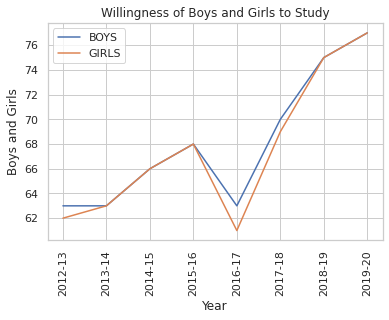

In [ ]:
sns.lineplot(x = stud_year,y = boys,label = "BOYS")
sns.lineplot(x = stud_year,y = girls,label = "GIRLS")
plt.xticks(rotation = 90)
plt.xlabel('Year')
plt.ylabel('Boys and Girls')
plt.title('Willingness of Boys and Girls to Study')
plt.show()

**1) Visualization using Barplot to see the count of students in each school management type for a district**

**2) Creating a dataframe with the district and the best school management type for that district(based on max student enrollment)** 

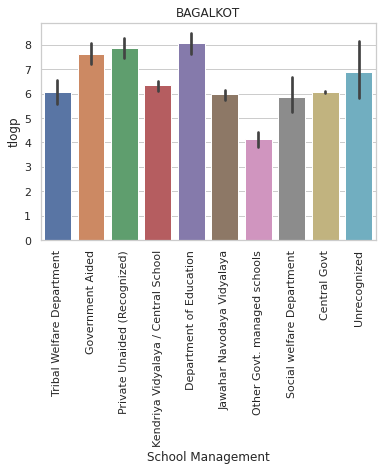

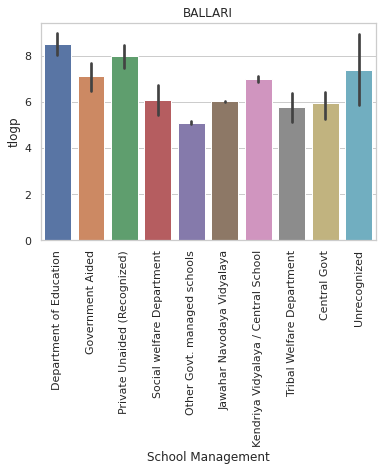

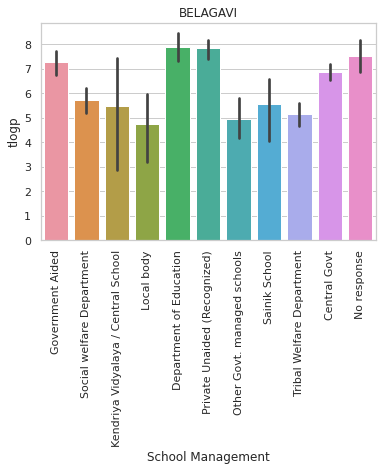

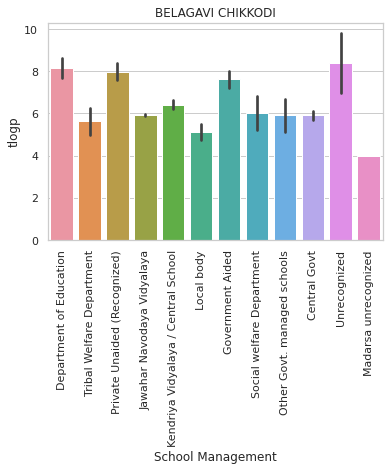

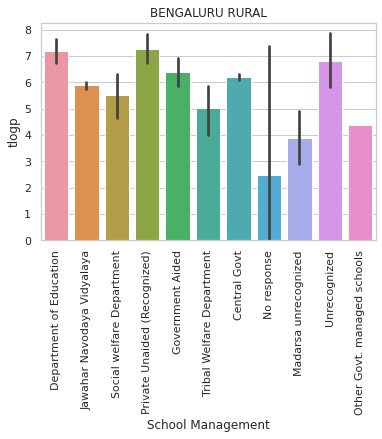

...

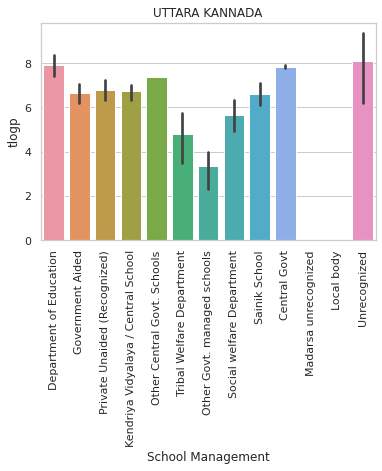

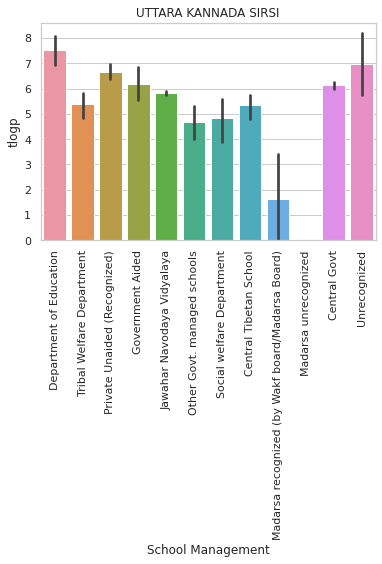

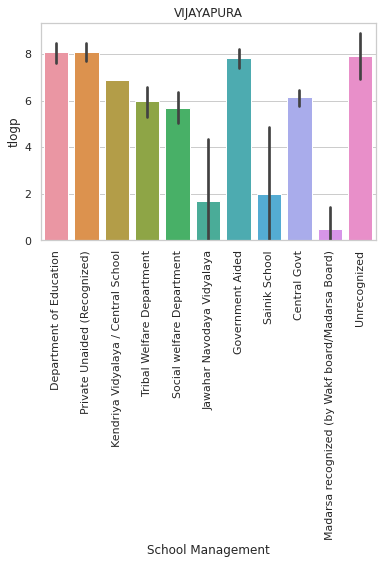

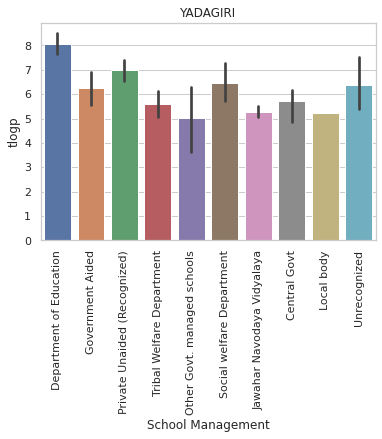

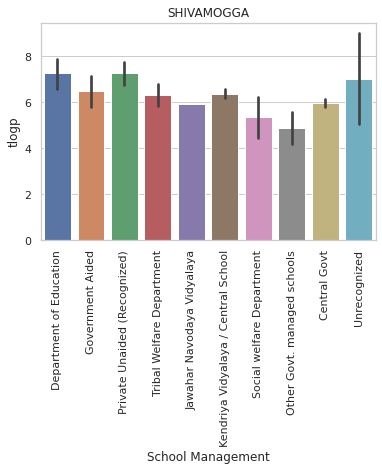

,District,Best Model
0,BAGALKOT,Department of Education
1,BALLARI,Department of Education
2,BELAGAVI,Department of Education
4,BENGALURU (RURAL),Private Unaided (Recognized)
6,BENGALURU (URBAN),Private Unaided (Recognized)
7,BIDAR,Department of Education
8,CHAMARAJANAGARA,Department of Education
9,CHIKKABALLAPURA,Department of Education
10,CHIKKAMAGALURU,Department of Education
11,CHITRADURGA,Department of Education


30


In [ ]:
sns.set_theme(style="whitegrid")
count=0
out=[]
for district in list_of_districts:
    students['tlogp']=np.log1p(students['TotalWithPre-Primary_Total'])
    ax=sns.barplot(x="School Management",y="tlogp", data=students.loc[students['Location']==district])
    plt.title(district)
    plt.xticks(rotation = 90)
    plt.show()
    count+=1
    df_subset = students[students['Location'] == district]
    most_profitable_school_model=df_subset.loc[df_subset['tlogp'] == max(df_subset['tlogp']), 'School Management']
    most_profitable_school_model = ''.join([i for i in most_profitable_school_model if not i.isdigit()])
    best_model= []
    best_model.append(district)
    best_model.append(most_profitable_school_model)
    out.append(best_model)
output_df = pd.DataFrame(out, columns = ['District', 'Best Model'])
output_df=output_df.drop(output_df.index[[3,5,27,30]])
output_df['District']= output_df['District'].str.replace('BENGALURU RURAL', 'BENGALURU (RURAL)')
output_df['District']= output_df['District'].str.replace('BENGALURU U SOUTH', 'BENGALURU (URBAN)')
output_df['District']= output_df['District'].str.replace('KOLAR', 'KOLARA')
output_df['District']= output_df['District'].str.replace('YADAGIRI', 'YADGIR')
output_df['District']= output_df['District'].str.replace('KALABURGI', 'KALBURGI')
output_df['District']= output_df['District'].str.replace('CHIKKAMANGALURU', 'CHIKKAMAGALURU')
output_df['Best Model'] = output_df['Best Model'].apply(lambda x: x.replace("Private Unaided (Recognized)Private Unaided (Recognized)", "Private Unaided (Recognized)"))

count=count-4
display(output_df)
print(count)

**Geopandas map to see the best school models for each district**

In [ ]:
!pip install geopandas

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd

In [ ]:
# set the filepath and load
fp = "/content/District_Boundary.shp"
#reading the file stored in variable fp
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe
map_df['KGISDist_1']=map_df['KGISDist_1'].str.upper()
map_df

,OBJECTID,KGISDistri,KGISDist_1,BhuCodeDis,created_us,created_da,last_edite,last_edi_1,SHAPE_STAr,SHAPE_STLe,geometry
0,1,01,BELAGAVI,01,None,None,SA,2020-11-10,1.339922e+10,1.142854e+06,"MULTIPOLYGON (((504399.697 1817491.814, 504355..."
1,2,02,BAGALKOT,02,None,None,SA,2020-11-07,6.561945e+09,6.685642e+05,"POLYGON ((579645.967 1748387.143, 579491.116 1..."
2,3,03,VIJAYAPURA,03,None,None,None,None,1.050303e+10,7.032936e+05,"POLYGON ((636177.875 1786177.573, 635767.770 1..."
3,4,04,KALBURGI,04,None,None,SA,2020-11-09,1.097529e+10,9.164460e+05,"MULTIPOLYGON (((680658.578 1957069.034, 680648..."
4,5,05,BIDAR,05,None,None,None,None,5.453885e+09,5.747318e+05,"MULTIPOLYGON (((740604.739 2041864.766, 740316..."
5,6,06,RAICHUR,06,None,None,None,None,8.470592e+09,5.536779e+05,"POLYGON ((694398.973 1719625.527, 694385.289 1..."
6,7,07,KOPPAL,07,None,None,SA,2020-11-05,5.576422e+09,5.481611e+05,"POLYGON ((602220.973 1673709.786, 602220.532 1..."
7,8,08,GADAG,08,None,None,SA,2020-11-05,4.655016e+09,5.699242e+05,"POLYGON ((579274.274 1652208.842, 579145.275 1..."
8,9,09,DHARWAD,09,None,None,SA,2020-11-10,4.254685e+09,4.784881e+05,"POLYGON ((491003.724 1662606.699, 490956.709 1..."
9,10,10,UTTARA KANNADA,10,None,None,SA,2020-11-13,1.029688e+10,8.020216e+05,"MULTIPOLYGON (((403370.123 1644838.989, 403187..."


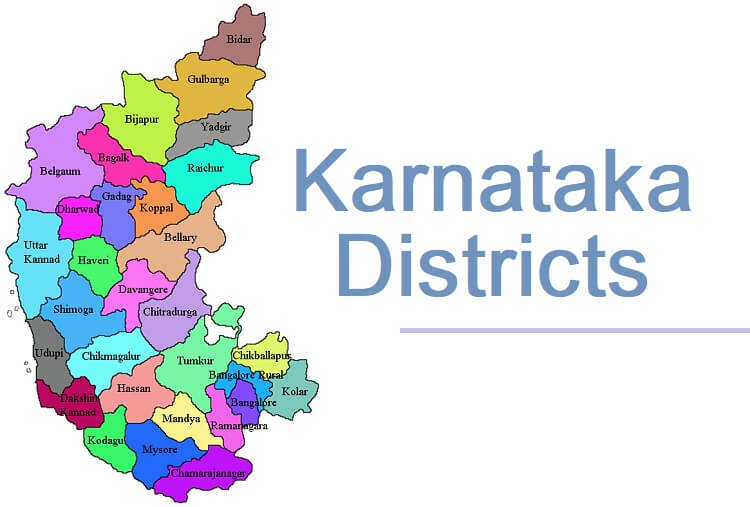

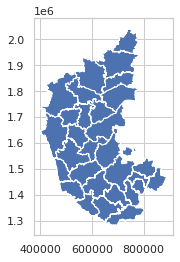

In [ ]:
#plotting the map of the shape file preview of the maps without data in it
map_df.plot()

In [ ]:
# joining the geodataframe with the cleaned up csv dataframe
merged = map_df.set_index('KGISDist_1').join(output_df.set_index('District'))
#.head() returns the top 5(by default ) lines of the dataframe

merged.head()

,OBJECTID,KGISDistri,BhuCodeDis,created_us,created_da,last_edite,last_edi_1,SHAPE_STAr,SHAPE_STLe,geometry,Best Model
KGISDist_1,,,,,,,,,,,
BELAGAVI,1,01,01,None,None,SA,2020-11-10,1.339922e+10,1.142854e+06,"MULTIPOLYGON (((504399.697 1817491.814, 504355...",Department of Education
BAGALKOT,2,02,02,None,None,SA,2020-11-07,6.561945e+09,6.685642e+05,"POLYGON ((579645.967 1748387.143, 579491.116 1...",Department of Education
VIJAYAPURA,3,03,03,None,None,None,None,1.050303e+10,7.032936e+05,"POLYGON ((636177.875 1786177.573, 635767.770 1...",Department of Education
KALBURGI,4,04,04,None,None,SA,2020-11-09,1.097529e+10,9.164460e+05,"MULTIPOLYGON (((680658.578 1957069.034, 680648...",Department of Education
BIDAR,5,05,05,None,None,None,None,5.453885e+09,5.747318e+05,"MULTIPOLYGON (((740604.739 2041864.766, 740316...",Department of Education


In [ ]:
merged['geometry'].apply(lambda x: x.wkt).values


array(['MULTIPOLYGON (((504399.6968 1817491.813999999, 504355.4468 1817500.584799999, 504279.4671 1817515.6447, 504204.7830999997 1817530.447699999, 504155.5958000002 1817529.3993, 503993.5407999996 1817525.945, 503995.0892000003 1817534.8071, 503995.1171000004 1817534.966499999, 503995.8299000002 1817539.0463, 504004.6490000002 1817589.5199, 504009.5181999998 1817616.460899999, 504019.2971999999 1817670.5669, 504036.9219000004 1817768.082800001, 504038.9780000001 1817779.087300001, 504048.2620000001 1817828.778000001, 504049.307 1817834.371200001, 504049.4310999997 1817835.0353, 504050.3490000004 1817839.9482, 504051.4676000001 1817845.935000001, 504055.2939999998 1817870.249, 504055.3871999998 1817870.8413, 504057.6934000002 1817885.5097, 504060.8498999998 1817905.5868, 504065.9847999997 1817938.247099999, 504067.8930000002 1817950.384400001, 504068.2505000001 1817952.6581, 504072.1719000004 1817978.777899999, 504096.4645999996 1818140.5901, 504097.6321999999 1818148.3671, 504102.326

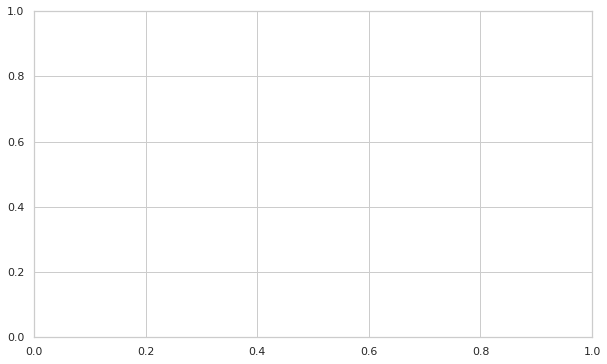

In [ ]:
# set a variable that will call whatever column we want to visualise on the map
variable = 'Best Model'
# set the range for the choropleth
vmin, vmax = 120, 220
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(10, 6))

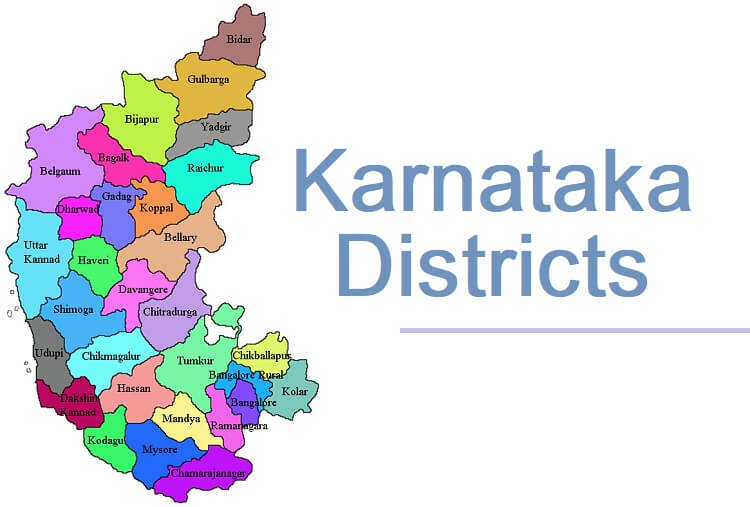

Dark blue - Dept of Education
Light blue - Private Unaided Recognized


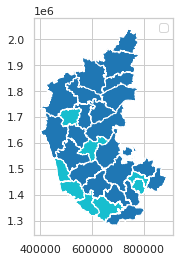

In [ ]:
merged.plot(column=variable)
import matplotlib.pyplot as plt
#plt.plot(column=variable, cmap='BuGn', linewidth=0.8, ax=ax, edgecolor='0.8')
#plt.plot(merged['Best Model'])
plt.legend(['Best Model'])
print("Dark blue - Dept of Education")
print("Light blue - Private Unaided Recognized")
plt.show()

States 

# Objective 3- Finding out the trend in the continuity of education for girls in various districts.

In [ ]:
import seaborn as sns
from sklearn.preprocessing import StandardScaler
sns.set_theme(style="ticks")
scaler = StandardScaler()
dots = students
#dots = dots.astype({'HigherSecondary(XI-XII)_Girls': 'int64'},errors='ignore')
#dots = dots.astype({'Secondary(IX-X)_Girls': 'int64'},errors='ignore')
dots1 = dots['HigherSecondary(XI-XII)_Girls']
dots1.astype('int64',errors='ignore')
dots['12th growth']=np.log1p(dots1)


In [ ]:
dots

,Location,Year,Rural/Urban,School Category,School Management,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,class_I_Girls,class_I_Boys,class_I_Total,class_II_Girls,class_II_Boys,class_II_Total,class_III_Girls,class_III_Boys,class_III_Total,class_IV_Girls,class_IV_Boys,class_IV_Total,class_V_Girls,class_V_Boys,class_V_Total,class_VI_Girls,class_VI_Boys,class_VI_Total,class_VII_Girls,class_VII_Boys,class_VII_Total,class_VIII_Girls,class_VIII_Boys,class_VIII_Total,class_IX_Girls,class_IX_Boys,class_IX_Total,class_X_Girls,class_X_Boys,class_X_Total,class_XI_Girls,class_XI_Boys,class_XI_Total,class_XII_Girls,class_XII_Boys,class_XII_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total,TotalWithoutPre-Primary_Girls,TotalWithoutPre-Primary_Boys,TotalWithoutPre-Primary_Total,TotalWithPre-Primary_Girls,TotalWithPre-Primary_Boys,TotalWithPre-Primary_Total,12th growth
0,BAGALKOT,2019-20,Rural,PS (I-V),Tribal Welfare Department,0,0,0,3,6,9,9,10,19,5,18,23,10,24,34,18,22,40,560,455,1015,664,538,1202,678,481,1159,413,300,713,348,245,593,57,26,83,16,19,35,45,80,125,1902,1474,3376,761,545,1306,73,45,118,2781,2144,4925,2781,2144,4925,4.304065
1,BAGALKOT,2019-20,Urban,PS (I-V),Government Aided,51,64,115,1010,1165,2175,964,1248,2212,956,1162,2118,1012,1239,2251,1115,1363,2478,1177,1450,2627,1165,1512,2677,1809,2110,3919,2153,2674,4827,1969,2412,4381,2012,3287,5299,1831,2714,4545,5057,6177,11234,4151,5072,9223,4122,5086,9208,3843,6001,9844,17173,22336,39509,17224,22400,39624,8.254269
2,BAGALKOT,2019-20,Urban,PS (I-V),Private Unaided (Recognized),3393,4349,7742,3186,4141,7327,3013,4222,7235,2739,4084,6823,2533,3671,6204,2291,3328,5619,2001,3097,5098,2012,2948,4960,2084,2774,4858,2205,2748,4953,2072,2357,4429,2580,2665,5245,2280,2259,4539,13762,19446,33208,6097,8819,14916,4277,5105,9382,4860,4924,9784,28996,38294,67290,32389,42643,75032,8.488999
3,BAGALKOT,2019-20,Urban,PS (I-V),Kendriya Vidyalaya / Central School,0,0,0,34,21,55,25,27,52,35,49,84,30,54,84,37,46,83,46,54,100,39,39,78,25,23,48,34,18,52,20,23,43,0,0,0,0,0,0,161,197,358,110,116,226,54,41,95,0,0,0,325,354,679,325,354,679,0.000000
4,BAGALKOT,2019-20,Rural,PS (I-V),Department of Education,141,140,281,8421,7579,16000,9541,8588,18129,9337,8616,17953,10276,8975,19251,10446,9161,19607,9782,8828,18610,9999,8779,18778,8257,7530,15787,6004,6547,12551,5281,4961,10242,1255,1278,2533,975,804,1779,48021,42919,90940,28038,25137,53175,11285,11508,22793,2230,2082,4312,89574,81646,171220,89715,81786,171501,7.710205
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11929,SHIVAMOGGA,2012-13,Urban,UPS (I-VIII),Private Unaided (Recognized),0,0,0,2168,2650,4818,2110,2538,4648,2169,2524,4693,2148,2447,4595,2095,2462,4557,2049,2315,4364,2001,2203,4204,39,50,89,0,0,0,0,0,0,0,0,0,0,0,0,10690,12621,23311,4089,4568,8657,0,0,0,0,0,0,14779,17189,31968,14779,17189,31968,0.000000
11930,SHIVAMOGGA,2012-13,Urban,UPS (I-VIII),Central Govt,0,0,0,21,23,44,21,22,43,20,22,42,20,23,43,20,23,43,22,22,44,25,15,40,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,102,113,215,47,37,84,0,0,0,0,0,0,149,150,299,149,150,299,0.000000
11931,SHIVAMOGGA,2012-13,Rural,UPS (VI-VIII),Department of Education,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,46,69,115,36,63,99,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,82,132,214,0,0,0,0,0,0,82,132,214,82,132,214,0.000000
11932,SHIVAMOGGA,2012-13,Urban,UPS (VI-VIII),Tribal Welfare Department,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11,23,34,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11,23,34,0,0,0,0,0,0,11,23,34,11,23,34,0.000000


In [ ]:
import plotly.express as px
fig = px.line(dots,x="Year", y="12th growth", color='School Management',facet_col='Location',facet_col_wrap=5,
                 width=3000, height=2000)
fig.show()

# Objective 4 - Understanding the population distribution between rural and urban areas and how one is better than the other.

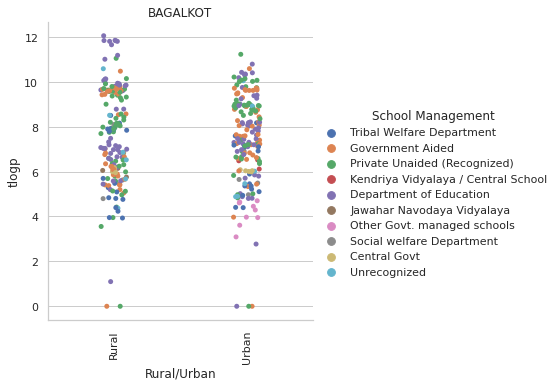

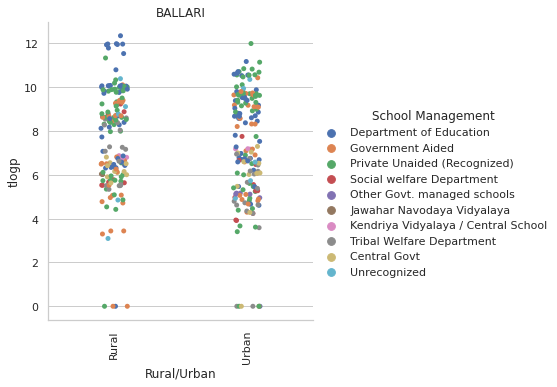

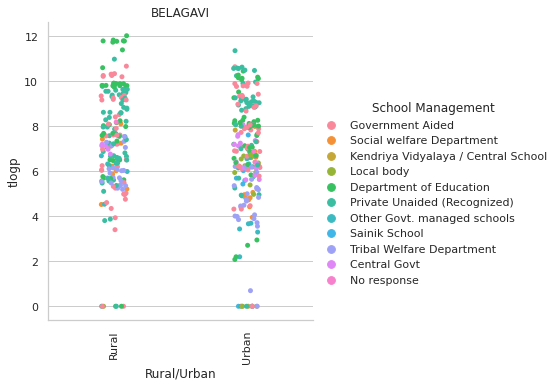

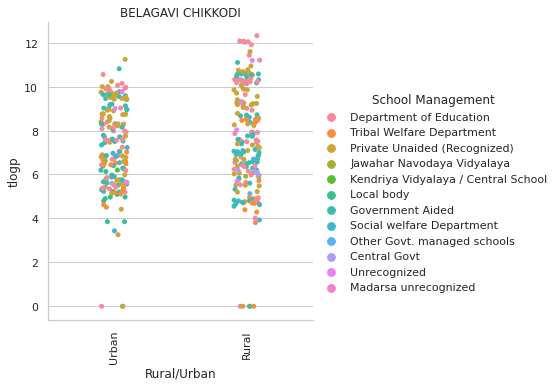

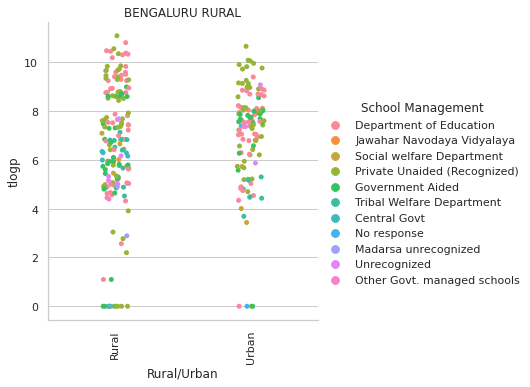

...

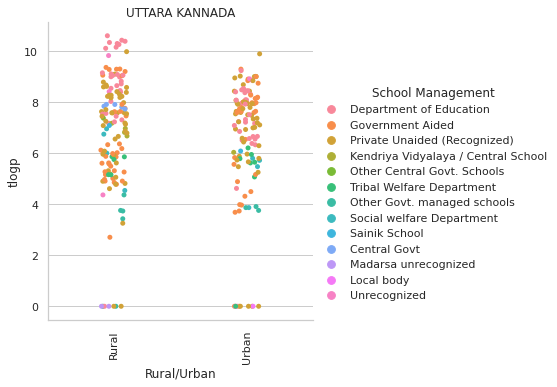

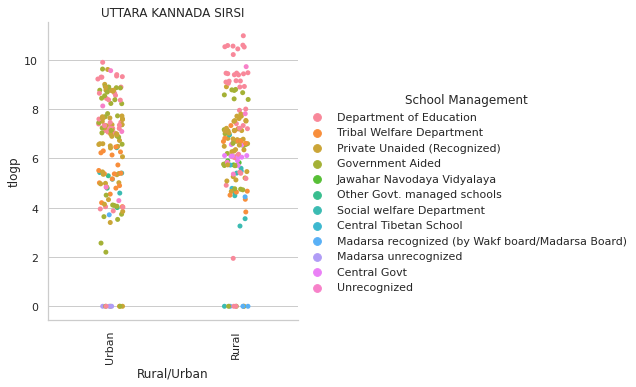

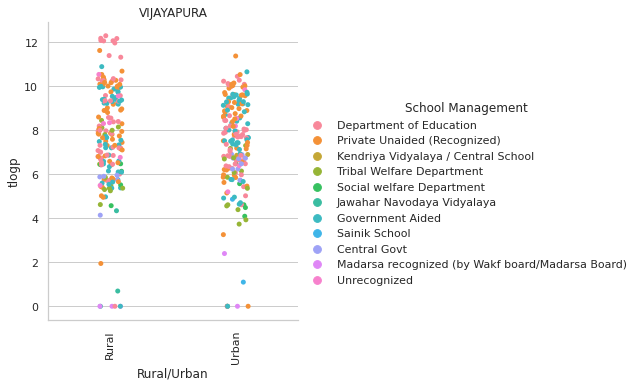

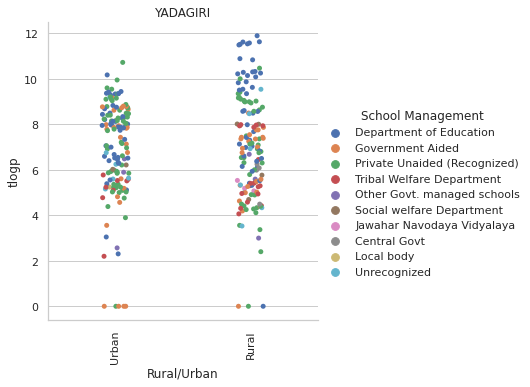

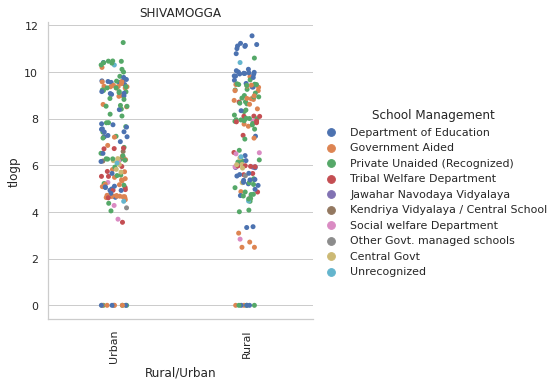

34


In [ ]:
list_of_districts=list(dots['Location'].unique())
sns.set_theme(style="whitegrid")
count=0
#district_area = students.groupby(['Location','Rural/Urban'], as_index=False).agg(lambda x: sum(x)).drop(['Year','School Category','School Management'],axis = 1)
dots['tlogp']=np.log1p(dots['TotalWithPre-Primary_Total'])
#summed_district_wise['tglogp']=np.log1p(summed_district_wise['TotalWithPre-Primary_Girls'])

for district in list_of_districts:
    data = dots.loc[students['Location']==district]
    sns.catplot(data = data, x = 'Rural/Urban',y = 'tlogp', hue = 'School Management')
    plt.title(district)
    plt.ylabel('tlogp')
    plt.xticks(rotation = 90)
    plt.show()
    count+=1
print(count)

# MACHINE LEARNING ALGORITHMS 
1. REGRESSION PLOT TO FIND OUT NUMBER OF SCHOOLS FOR EACH YEAR BASED ON THE INFRASTRUCTURE DATA PROVIDED

In [ ]:
import pandas as pd 
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

**Reading and cleaning data from the Infrastructure dataset from UDISE+**

In [ ]:
#Import the data
data_tsne = pd.read_csv("/content/tsne - ag-grid.csv")
print('Raw data from UDISE : ')
print(data_tsne.columns)

Raw data from UDISE : 
Index(['Year', 'Location', 'Rural/Urban', 'School_Category ',
       'School_Management', 'School_Type ', 'Total_No_of_Schools',
       'Separate Room for Headmaster', 'Land Available', 'Electricity ',
       'Functional Electricity', 'Solar Panel', 'Playground',
       'Library or Reading Corner or Book Bank', 'Librarian', 'Newspaper',
       'Kitchen Garden', 'Furniture', 'Boy's Toilet',
       'Functional Boy's Toilet', 'Girl's Toilet', 'Functional Girl's Toilet',
       'Toilet Facility', 'Functional Toilet Facility',
       'Functional Urinal Boy's', 'Functional Urinal Girl's',
       'Functional Urinal', 'Functional Toilet and Urinal', 'Drinking Water',
       'Functional Drinking Water ', 'Water Purifier', 'Rain Water Harvesting',
       'Water Tested', 'Handwash', 'Incinerator',
       'WASH Facility(Drinking Water, Toilet and Handwash)', 'Ramps',
       'Hand-Rails', 'Medical Checkup', 'Complete Medical Checkup', 'Internet',
       'Computer Available'],

**Finding any missing values**

In [ ]:
b=list(data_tsne.columns)
for i in b:
    print(i)
    print(data_tsne[data_tsne[i].isna()].index.tolist())

Year
[]
Location
[]
Rural/Urban
[831]
School_Category 
[]
School_Management
[]
School_Type 
[]
Total_No_of_Schools
[]
Separate Room for Headmaster
[]
Land Available
[]
Electricity 
[]
Functional Electricity
[]
Solar Panel
[]
Playground
[]
Library or Reading Corner or Book Bank
[]
Librarian
[]
Newspaper
[]
Kitchen Garden
[]
Furniture
[]
Boy's Toilet
[]
Functional Boy's Toilet
[]
Girl's Toilet
[]
Functional Girl's Toilet
[]
Toilet Facility
[]
Functional Toilet Facility
[]
Functional Urinal Boy's
[]
Functional Urinal Girl's
[]
Functional Urinal
[]
Functional Toilet and Urinal
[]
Drinking Water
[]
Functional Drinking Water 
[]
Water Purifier
[]
Rain Water Harvesting
[]
Water Tested
[]
Handwash
[]
Incinerator
[]
WASH Facility(Drinking Water, Toilet and Handwash)
[]
Ramps
[]
Hand-Rails
[]
Medical Checkup
[]
Complete Medical Checkup
[]
Internet
[]
Computer Available
[]


In [ ]:
#Remove UNNECCESARY columns
data_tsne= data_tsne.drop(['Location', 'Separate Room for Headmaster','Functional Electricity',
       'Solar Panel',  'Librarian', 'Newspaper', 'Kitchen Garden','Boy\'s Toilet',
       'Functional Boy\'s Toilet', 'Girl\'s Toilet', 'Functional Girl\'s Toilet', 'Functional Urinal Boy\'s', 'Functional Urinal Girl\'s',
       'Functional Urinal', 'Functional Toilet and Urinal','Drinking Water',
       'Functional Drinking Water ', 'Handwash', 'Incinerator', 'Ramps',
       'Hand-Rails', 'Complete Medical Checkup'],axis=1) 
print('\n\nData after removing Date and Adj Close : ')
print(data_tsne.head())



Data after removing Date and Adj Close : 
      Year Rural/Urban  ... Internet Computer Available
0  2019-20       Rural  ...        0                  1
1  2019-20       Rural  ...        2                  2
2  2019-20       Rural  ...        1                  1
3  2019-20       Urban  ...       66                145
4  2019-20       Urban  ...       42                 98

[5 rows x 20 columns]


In [ ]:
data_tsne['School_Management'].unique()

array(['Central Tibetan School', 'Department of Education',
       'Government Aided', 'Jawahar Navodaya Vidyalaya ',
       'Kendriya Vidyalaya / Central School', 'Local body',
       'Madarsa recognized (by Wakf board/Madarsa Board) ',
       'Madarsa unrecognized', 'Other Central Govt. Schools',
       'Other Govt. managed schools', 'Private Unaided (Recognized)',
       'Railway School', 'Sainik School', 'Social welfare Department',
       'Tribal Welfare Department', 'Unrecognized',
       'Jawahar Navodaya Vidyalaya', 'Ministry of Labor', 'Central Govt',
       'No response'], dtype=object)

array([ 1,  2,  3,  5,  6,  7,  8,  9, 12, 13, 14, 15, 16, 17, 18, 19,  4,
       10,  0, 11])

**Checking datatypes to see if they must be label encoded later**

In [ ]:
e=list(data_tsne.dtypes)
e

[dtype('O'),
 dtype('O'),
 dtype('O'),
 dtype('O'),
 dtype('O'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64'),
 dtype('int64')]

**Creating a copy of the dataframe to use for clustering later-on**

In [ ]:
data2= data_tsne.copy()

In [ ]:
data2.columns

Index(['Year', 'Rural/Urban', 'School_Category ', 'School_Management',
       'School_Type ', 'Total_No_of_Schools', 'Land Available', 'Electricity ',
       'Playground', 'Library or Reading Corner or Book Bank', 'Furniture',
       'Toilet Facility', 'Functional Toilet Facility', 'Water Purifier',
       'Rain Water Harvesting', 'Water Tested',
       'WASH Facility(Drinking Water, Toilet and Handwash)', 'Medical Checkup',
       'Internet', 'Computer Available'],
      dtype='object')

**Label encoding object type categorical data**

In [ ]:
cat_features=[x for x in data_tsne.columns if data_tsne[x].dtype=="object"]

le=LabelEncoder()

for col in cat_features:
    if col in data_tsne.columns:
        i = data_tsne.columns.get_loc(col)
        data_tsne.iloc[:,i] = data_tsne.apply(lambda i:le.fit_transform(i.astype(str)), axis=0, result_type='expand')

**Visualizing the correlations among features**

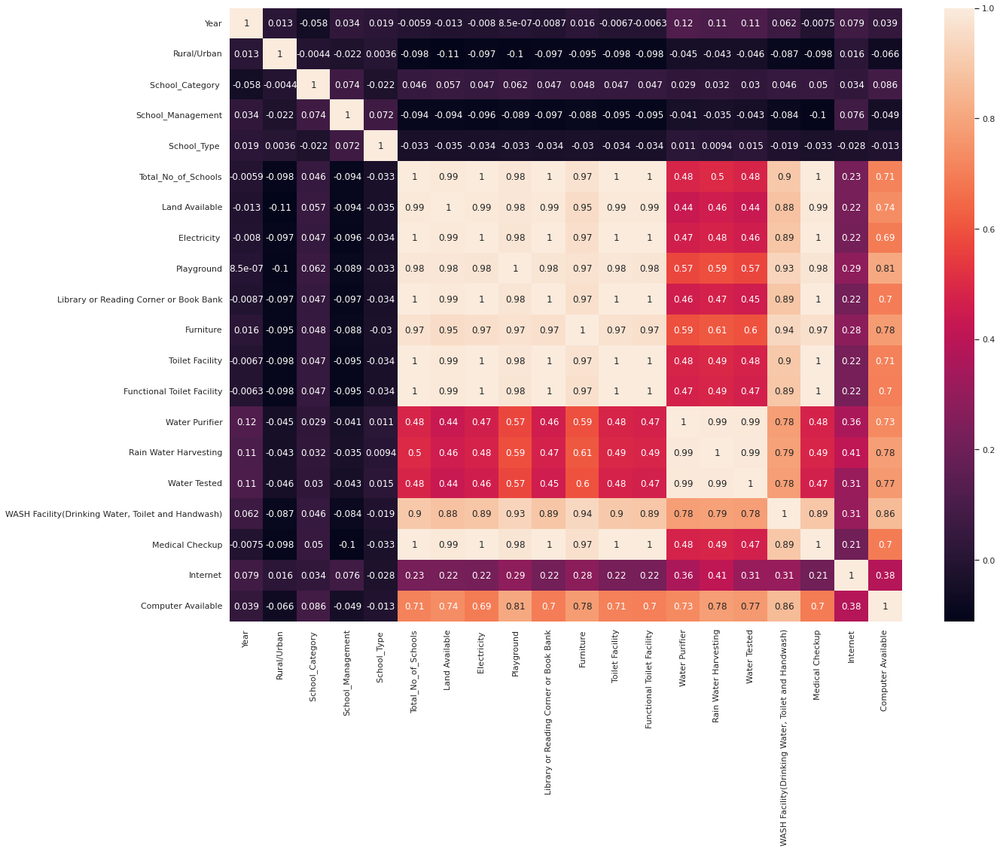

In [ ]:

corr_matrix = data_tsne.corr()
plt.figure(figsize=(20,15))
sns.heatmap(corr_matrix, annot=True)
plt.show()

**Training and testing linear regression model**

In [ ]:
#Split into train and test data
data_X = data_tsne.loc[:,data_tsne.columns !=  'Total_No_of_Schools' ]
data_Y = data_tsne['Total_No_of_Schools']
train_X, test_X, train_y,test_y = train_test_split(data_X,data_Y,test_size=0.25)
print('\n\nTraining Set')
print(train_X.head())
print(train_y.head())



Training Set
      Year  Rural/Urban  ...  Internet  Computer Available
1652     1            1  ...       533                1162
781      5            0  ...         0                   2
636      5            0  ...         0                   1
932      4            0  ...         8                  12
1362     2            1  ...         1                   1

[5 rows x 19 columns]
1652    1514
781        2
636        1
932       16
1362       4
Name: Total_No_of_Schools, dtype: int64


In [ ]:
#Creating the Regressor
regressor = LinearRegression()
regressor.fit(train_X,train_y)

LinearRegression()

In [ ]:
#Make Predictions and Evaluate the results
predict_y = regressor.predict(test_X)
print('Prediction Score : ' , regressor.score(test_X,test_y))
#error = mean_squared_error(test_y,predict_y)
#print('Mean Squared Error : ',error)

Prediction Score :  0.999535196840419


In [ ]:
from sklearn.model_selection import cross_val_score
print("R2 score :", cross_val_score(regressor, test_X,test_y, cv=10, scoring="r2").mean())

R2 score : 0.9972414827366638


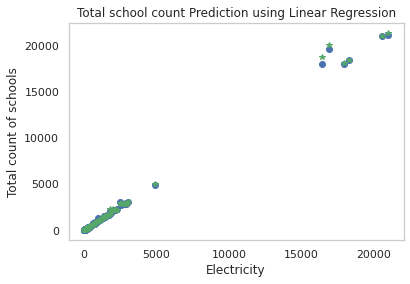

In [ ]:
#Plot the predicted and the expected values
fig = plt.figure()
ax = plt.axes()
ax.grid()
ax.set(xlabel='Electricity',ylabel='Total count of schools', title='Total school count Prediction using Linear Regression')
ax.plot(test_X['Electricity '],test_y,'bo')
ax.plot(test_X['Electricity '],predict_y,'g*')
fig.savefig('LRPlot.png')
plt.show()

# MACHINE LEARNING ALGORITHMS 
1. TSNE - TO REDUCE DIMENSIONALITY 
2. AGGLOMERATIVE/HIERARCHIAL CLUSTERING OF DIFFERENT SCHOOL MANAGEMENT TYPES BASED ON SIMILARITIES 

In [ ]:
cat_features=[x for x in data2.columns if data2[x].dtype=="object"]
le=LabelEncoder()

for col in cat_features:
    if col in data2.columns:
        i = data2.columns.get_loc(col)
        data2.iloc[:,i] = data2.apply(lambda i:le.fit_transform(i.astype(str)), axis=0, result_type='expand')


**Selecting features to use for clustering**

In [ ]:
for_cluster = data2[['School_Category ', 'School_Management',
       'School_Type ', 'Total_No_of_Schools', 'Land Available',
       'Electricity ', 'Playground', 'Library or Reading Corner or Book Bank',
       'Furniture', 'Toilet Facility', 'Functional Toilet Facility',
       'Water Purifier', 'Rain Water Harvesting', 'Water Tested',
       'WASH Facility(Drinking Water, Toilet and Handwash)', 'Medical Checkup',
       'Internet', 'Computer Available']]
for_cluster = for_cluster.groupby(['School_Management']).agg('mean').reset_index()
for_cluster

,School_Management,School_Category,School_Type,Total_No_of_Schools,Land Available,Electricity,Playground,Library or Reading Corner or Book Bank,Furniture,Toilet Facility,Functional Toilet Facility,Water Purifier,Rain Water Harvesting,Water Tested,"WASH Facility(Drinking Water, Toilet and Handwash)",Medical Checkup,Internet,Computer Available
0,0,6.610526,0.978947,7.926316,4.157895,7.768421,7.389474,7.821053,6.452632,6.378947,6.357895,0.000000,1.484211,0.000000,2.557895,6.052632,3.263158,4.873684
1,1,3.444444,1.333333,1.666667,1.333333,1.555556,1.444444,1.666667,1.666667,1.666667,1.666667,0.777778,0.666667,0.666667,1.444444,1.222222,1.222222,1.555556
2,2,7.581081,1.418919,1052.586486,676.202703,1024.043243,712.548649,1028.524324,769.032432,1046.500000,1037.145946,150.345946,121.794595,171.702703,511.100000,1008.262162,22.132432,356.859459
3,3,7.867257,1.351032,159.144543,118.221239,152.471976,144.964602,153.675516,145.961652,158.321534,156.430678,30.221239,29.926254,31.693215,89.088496,145.404130,28.215339,94.513274
4,4,7.125000,2.000000,3.875000,2.500000,3.250000,3.500000,3.375000,3.750000,3.750000,3.750000,2.625000,2.000000,2.625000,3.375000,2.500000,1.875000,3.750000
5,5,7.333333,1.000000,6.555556,5.111111,6.555556,6.000000,6.333333,5.666667,6.555556,6.555556,3.111111,3.555556,3.222222,4.888889,5.555556,5.888889,6.222222
6,6,5.846154,1.384615,6.000000,3.692308,5.423077,5.346154,5.538462,5.423077,5.500000,5.461538,3.307692,3.230769,3.307692,4.884615,4.576923,4.000000,5.692308
7,7,7.700000,1.333333,5.688889,3.166667,5.411111,4.388889,5.211111,5.366667,5.577778,5.533333,1.000000,2.066667,0.988889,2.811111,5.011111,0.944444,4.277778
8,8,7.857143,0.809524,1.690476,0.595238,0.976190,0.928571,0.928571,0.928571,0.976190,0.952381,0.190476,0.095238,0.214286,0.571429,0.690476,0.047619,0.809524
9,9,7.806452,0.983871,1.532258,0.870968,1.274194,0.951613,1.048387,0.967742,1.306452,1.274194,0.064516,0.064516,0.064516,0.290323,0.838710,0.032258,0.516129


**Perform TSNE and Agglomerative clustering**

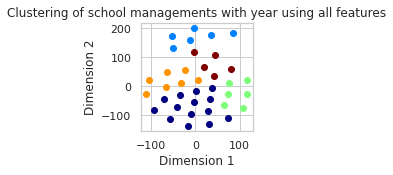

In [ ]:
from matplotlib.axes._axes import _log as matplotlib_axes_logger
from sklearn.manifold import TSNE
from sklearn.cluster import AgglomerativeClustering
matplotlib_axes_logger.setLevel('ERROR')
for_cluster = data2[[ 'Rural/Urban','School_Category ', 'School_Management',
       'School_Type ', 'Total_No_of_Schools', 'Land Available',
       'Electricity ', 'Playground', 'Library or Reading Corner or Book Bank',
       'Furniture', 'Toilet Facility', 'Functional Toilet Facility',
       'Water Purifier', 'Rain Water Harvesting', 'Water Tested',
       'WASH Facility(Drinking Water, Toilet and Handwash)', 'Medical Checkup',
       'Internet', 'Computer Available']]
for_cluster = for_cluster.groupby(['Rural/Urban','School_Management']).agg('mean').reset_index()
for_cluster.head()
X = TSNE(n_components=2).fit_transform(for_cluster.iloc[:,0:])
clustering = AgglomerativeClustering(n_clusters=5).fit(X)
y=clustering.labels_
list(set(y))
N= len(list(set(y)))
cmap = mplot.cm.jet
colors = cmap(np.linspace(0, 1, N))
fig = mplot.figure(figsize=(2,2))
for i in list(set(y)):
    mplot.scatter(X[y==i,0],X[y==i,1],c=colors[i],label=str('Class '+str(i)))
mplot.xlabel("Dimension 1")
mplot.ylabel("Dimension 2")
mplot.title('Clustering of school managements with year using all features')
mplot.show()

**Cluster Description**

In [ ]:
for i in range(5):
    print('Cluster ',i,list(set(for_cluster.School_Management[y==i].values)),'\n')

Cluster  0 [0, 2, 4, 5, 6, 7, 9, 10, 11, 12, 15] 

Cluster  1 [19, 2, 3, 14] 

Cluster  2 [0, 1, 9, 11, 18] 

Cluster  3 [5, 7, 8, 13, 16] 

Cluster  4 [16, 17, 3, 19] 



# OBJECTIVE 5: Relationship between Students and Teachers (Ratio)

In [ ]:
import pandas as pd
data1 = pd.read_csv('FDS STU FINAL.csv').iloc[:,:62]
data1.drop(data1.columns[[3]], axis = 1, inplace = True)
data1

,Location,Year,Rural/Urban,School Management,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,class_I_Girls,class_I_Boys,class_I_Total,class_II_Girls,class_II_Boys,class_II_Total,class_III_Girls,class_III_Boys,class_III_Total,class_IV_Girls,class_IV_Boys,class_IV_Total,class_V_Girls,class_V_Boys,class_V_Total,class_VI_Girls,class_VI_Boys,class_VI_Total,class_VII_Girls,class_VII_Boys,class_VII_Total,class_VIII_Girls,class_VIII_Boys,class_VIII_Total,class_IX_Girls,class_IX_Boys,class_IX_Total,class_X_Girls,class_X_Boys,class_X_Total,class_XI_Girls,class_XI_Boys,class_XI_Total,class_XII_Girls,class_XII_Boys,class_XII_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total,TotalWithoutPre-Primary_Girls,TotalWithoutPre-Primary_Boys,TotalWithoutPre-Primary_Total,TotalWithPre-Primary_Girls,TotalWithPre-Primary_Boys,TotalWithPre-Primary_Total
0,BAGALKOT,2019-20,Rural,Tribal Welfare Department,0,0,0,3,6,9,9,10,19,5,18,23,10,24,34,18,22,40,560,455,1015,664,538,1202,678,481,1159,413,300,713,348,245,593,57,26,83,16,19,35,45,80,125,1902,1474,3376,761,545,1306,73,45,118,2781,2144,4925,2781,2144,4925
1,BAGALKOT,2019-20,Urban,Government Aided,51,64,115,1010,1165,2175,964,1248,2212,956,1162,2118,1012,1239,2251,1115,1363,2478,1177,1450,2627,1165,1512,2677,1809,2110,3919,2153,2674,4827,1969,2412,4381,2012,3287,5299,1831,2714,4545,5057,6177,11234,4151,5072,9223,4122,5086,9208,3843,6001,9844,17173,22336,39509,17224,22400,39624
2,BAGALKOT,2019-20,Urban,Private Unaided (Recognized),3393,4349,7742,3186,4141,7327,3013,4222,7235,2739,4084,6823,2533,3671,6204,2291,3328,5619,2001,3097,5098,2012,2948,4960,2084,2774,4858,2205,2748,4953,2072,2357,4429,2580,2665,5245,2280,2259,4539,13762,19446,33208,6097,8819,14916,4277,5105,9382,4860,4924,9784,28996,38294,67290,32389,42643,75032
3,BAGALKOT,2019-20,Urban,Kendriya Vidyalaya / Central School,0,0,0,34,21,55,25,27,52,35,49,84,30,54,84,37,46,83,46,54,100,39,39,78,25,23,48,34,18,52,20,23,43,0,0,0,0,0,0,161,197,358,110,116,226,54,41,95,0,0,0,325,354,679,325,354,679
4,BAGALKOT,2019-20,Rural,Department of Education,141,140,281,8421,7579,16000,9541,8588,18129,9337,8616,17953,10276,8975,19251,10446,9161,19607,9782,8828,18610,9999,8779,18778,8257,7530,15787,6004,6547,12551,5281,4961,10242,1255,1278,2533,975,804,1779,48021,42919,90940,28038,25137,53175,11285,11508,22793,2230,2082,4312,89574,81646,171220,89715,81786,171501
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11929,SHIVAMOGGA,2012-13,Urban,Private Unaided (Recognized),0,0,0,2168,2650,4818,2110,2538,4648,2169,2524,4693,2148,2447,4595,2095,2462,4557,2049,2315,4364,2001,2203,4204,39,50,89,0,0,0,0,0,0,0,0,0,0,0,0,10690,12621,23311,4089,4568,8657,0,0,0,0,0,0,14779,17189,31968,14779,17189,31968
11930,SHIVAMOGGA,2012-13,Urban,Central Govt,0,0,0,21,23,44,21,22,43,20,22,42,20,23,43,20,23,43,22,22,44,25,15,40,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,102,113,215,47,37,84,0,0,0,0,0,0,149,150,299,149,150,299
11931,SHIVAMOGGA,2012-13,Rural,Department of Education,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,46,69,115,36,63,99,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,82,132,214,0,0,0,0,0,0,82,132,214,82,132,214
11932,SHIVAMOGGA,2012-13,Urban,Tribal Welfare Department,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11,23,34,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11,23,34,0,0,0,0,0,0,11,23,34,11,23,34


In [ ]:
studf = pd.DataFrame(columns=['Location', 'Year', 'School Management',
       'Pre_primary_girls', 'Pre_primary_Boys', 'Pre_primary_Total',
       'class_I_Girls', 'class_I_Boys', 'class_I_Total', 'class_II_Girls',
       'class_II_Boys', 'class_II_Total', 'class_III_Girls', 'class_III_Boys',
       'class_III_Total', 'class_IV_Girls', 'class_IV_Boys', 'class_IV_Total',
       'class_V_Girls', 'class_V_Boys', 'class_V_Total', 'class_VI_Girls',
       'class_VI_Boys', 'class_VI_Total', 'class_VII_Girls', 'class_VII_Boys',
       'class_VII_Total', 'class_VIII_Girls', 'class_VIII_Boys',
       'class_VIII_Total', 'class_IX_Girls', 'class_IX_Boys', 'class_IX_Total',
       'class_X_Girls', 'class_X_Boys', 'class_X_Total', 'class_XI_Girls',
       'class_XI_Boys', 'class_XI_Total', 'class_XII_Girls', 'class_XII_Boys',
       'class_XII_Total', 'Primary(I-V)_Girls', 'Primary(I-V)_Boys',
       'Primary(I-V)_Total', 'UpperPrimary(VI-VIII)_Girls',
       'UpperPrimary(VI-VIII)_Boys', 'UpperPrimary(VI-VIII)_Total',
       'Secondary(IX-X)_Girls', 'Secondary(IX-X)_Boys',
       'Secondary(IX-X)_Total', 'HigherSecondary(XI-XII)_Girls',
       'HigherSecondary(XI-XII)_Boys', 'HigherSecondary(XI-XII)_Total',
       'TotalWithoutPre-Primary_Girls', 'TotalWithoutPre-Primary_Boys',
       'TotalWithoutPre-Primary_Total', 'TotalWithPre-Primary_Girls',
       'TotalWithPre-Primary_Boys', 'TotalWithPre-Primary_Total'])

In [ ]:
data1 = data1.replace('Jawahar Navodaya Vidyalaya ', 'Jawahar Navodaya Vidyalaya')
data1 = data1.replace('Madarsa recognized (by Wakf board/Madarsa Board) ', 'Madarsa recognized (by Wakf board/Madarsa Board)')
data1.fillna({'Rural/Urban':'Rural'}, inplace=True)

In [ ]:
district = data1.Location.unique().tolist()
year = data1.Year.unique().tolist()
management = data1['School Management'].unique().tolist()

In [ ]:
import numpy as np
for k in district:
  for j in year:
    for i in management:
      df = data1.loc[(data1['Location'] == k) & 
                  (data1['Year'] == j) & 
                  (data1['School Management'] == i)]
  #print(df['School Management'])
  #total = []
      total = df.sum().tolist()
  #total = np.array(df.sum())
      if not np.all((np.array(total) == 0)):
        #print(len(total))
        total[0] = df.iat[0,0]
        total[1] = df.iat[0,1]
        total[3] = df.iat[0,3]
        del total[2]
        studf.loc[len(studf)] = total

In [ ]:
studf

,Location,Year,School Management,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,class_I_Girls,class_I_Boys,class_I_Total,class_II_Girls,class_II_Boys,class_II_Total,class_III_Girls,class_III_Boys,class_III_Total,class_IV_Girls,class_IV_Boys,class_IV_Total,class_V_Girls,class_V_Boys,class_V_Total,class_VI_Girls,class_VI_Boys,class_VI_Total,class_VII_Girls,class_VII_Boys,class_VII_Total,class_VIII_Girls,class_VIII_Boys,class_VIII_Total,class_IX_Girls,class_IX_Boys,class_IX_Total,class_X_Girls,class_X_Boys,class_X_Total,class_XI_Girls,class_XI_Boys,class_XI_Total,class_XII_Girls,class_XII_Boys,class_XII_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total,TotalWithoutPre-Primary_Girls,TotalWithoutPre-Primary_Boys,TotalWithoutPre-Primary_Total,TotalWithPre-Primary_Girls,TotalWithPre-Primary_Boys,TotalWithPre-Primary_Total
0,BAGALKOT,2019-20,Tribal Welfare Department,0,0,0,9,17,26,24,37,61,27,50,77,36,61,97,47,55,102,1048,880,1928,1129,1029,2158,1046,814,1860,587,438,1025,466,306,772,177,26,203,136,19,155,143,220,363,3223,2723,5946,1053,744,1797,313,45,358,4732,3732,8464,4732,3732,8464
1,BAGALKOT,2019-20,Government Aided,236,277,513,1937,2248,4185,1932,2462,4394,1917,2414,4331,1934,2515,4449,2034,2705,4739,2036,2745,4781,2053,2664,4717,4041,4689,8730,4914,6015,10929,4494,5615,10109,2886,4240,7126,2564,3438,6002,9754,12344,22098,8130,10098,18228,9408,11630,21038,5450,7678,13128,32742,41750,74492,32978,42027,75005
2,BAGALKOT,2019-20,Private Unaided (Recognized),6595,8760,15355,6412,9204,15616,5977,9103,15080,5385,8530,13915,4730,7784,12514,4198,6993,11191,3399,5612,9011,3261,5141,8402,3283,4472,7755,3501,4451,7952,3264,4116,7380,3475,3752,7227,3098,3283,6381,26702,41614,68316,9943,15225,25168,6765,8567,15332,6573,7035,13608,49983,72441,122424,56578,81201,137779
3,BAGALKOT,2019-20,Kendriya Vidyalaya / Central School,0,0,0,34,21,55,25,27,52,35,49,84,30,54,84,37,46,83,46,54,100,39,39,78,25,23,48,34,18,52,20,23,43,0,0,0,0,0,0,161,197,358,110,116,226,54,41,95,0,0,0,325,354,679,325,354,679
4,BAGALKOT,2019-20,Department of Education,141,140,281,10227,8996,19223,11450,10056,21506,11301,10146,21447,12643,10745,23388,12815,11118,23933,12357,10936,23293,12790,10976,23766,10771,9490,20261,8369,8371,16740,7467,6313,13780,4011,2981,6992,3431,1915,5346,58436,51061,109497,35918,31402,67320,15836,14684,30520,7442,4896,12338,117632,102043,219675,117773,102183,219956
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1805,SHIVAMOGGA,2012-13,Tribal Welfare Department,0,0,0,33,42,75,35,32,67,40,40,80,41,36,77,36,41,77,367,307,674,416,326,742,424,329,753,356,308,664,247,283,530,0,0,0,0,0,0,185,191,376,1207,962,2169,603,591,1194,0,0,0,1995,1744,3739,1995,1744,3739
1806,SHIVAMOGGA,2012-13,Government Aided,0,0,0,1229,1302,2531,1156,1253,2409,1194,1272,2466,1350,1460,2810,1359,1568,2927,1574,1647,3221,1599,1662,3261,3863,4191,8054,4094,4357,8451,3947,3579,7526,0,0,0,0,0,0,6288,6855,13143,7036,7500,14536,8041,7936,15977,0,0,0,21365,22291,43656,21365,22291,43656
1807,SHIVAMOGGA,2012-13,Private Unaided (Recognized),0,0,0,4351,5680,10031,4196,5098,9294,4136,4926,9062,3990,4587,8577,3774,4443,8217,3531,4333,7864,3507,4163,7670,2899,3714,6613,2614,3266,5880,2386,3017,5403,0,0,0,0,0,0,20447,24734,45181,9937,12210,22147,5000,6283,11283,0,0,0,35384,43227,78611,35384,43227,78611
1808,SHIVAMOGGA,2012-13,Department of Education,0,0,0,7873,7342,15215,7237,7428,14665,7836,7747,15583,8015,7916,15931,8465,8326,16791,8384,8514,16898,8745,8834,17579,7190,7169,14359,6195,6187,12382,5954,4938,10892,0,0,0,0,0,0,39426,38759,78185,24319,24517,48

In [ ]:
student = studf.copy()

In [ ]:
studf.drop(studf.iloc[:, 6:42], inplace = True, axis = 1)
studf.drop(studf.iloc[:, 18:], inplace = True, axis = 1)
studf

,Location,Year,School Management,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total
0,BAGALKOT,2019-20,Tribal Welfare Department,0,0,0,143,220,363,3223,2723,5946,1053,744,1797,313,45,358
1,BAGALKOT,2019-20,Government Aided,236,277,513,9754,12344,22098,8130,10098,18228,9408,11630,21038,5450,7678,13128
2,BAGALKOT,2019-20,Private Unaided (Recognized),6595,8760,15355,26702,41614,68316,9943,15225,25168,6765,8567,15332,6573,7035,13608
3,BAGALKOT,2019-20,Kendriya Vidyalaya / Central School,0,0,0,161,197,358,110,116,226,54,41,95,0,0,0
4,BAGALKOT,2019-20,Department of Education,141,140,281,58436,51061,109497,35918,31402,67320,15836,14684,30520,7442,4896,12338
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1805,SHIVAMOGGA,2012-13,Tribal Welfare Department,0,0,0,185,191,376,1207,962,2169,603,591,1194,0,0,0
1806,SHIVAMOGGA,2012-13,Government Aided,0,0,0,6288,6855,13143,7036,7500,14536,8041,7936,15977,0,0,0
1807,SHIVAMOGGA,2012-13,Private Unaided (Recognized),0,0,0,20447,24734,45181,9937,12210,22147,5000,6283,11283,0,0,0
1808,SHIVAMOGGA,2012-13,Department of Education,0,0,0,39426,38759,78185,24319,24517,48836,12149,11125,23274,0,0,0


In [ ]:
import pandas as pd
data2 = pd.read_csv('FDS FINAL TEACHERS.csv')
data2

,Location,Year,School Management,Pre-Primary Only(A) Female,Pre-Primary Only(A) Male,Pre-Primary Only(A) Total,Pre-Primary & Primary(I-V)(B) Female,Pre-Primary & Primary(I-V)(B) Male,Pre-Primary & Primary(I-V)(B) Total,Pre-Primary Total(A+B) Female,Pre-Primary Total(A+B) Male,Pre-Primary Total(A+B) Total,Primary Only(I-V)(C) Female,Primary Only(I-V)(C) Male,Primary Only(I-V)(C) Total,Primary(I-V) & Upper Primary(VI-VIII)(D) Female,Primary(I-V) & Upper Primary(VI-VIII)(D) Male,Primary(I-V) & Upper Primary(VI-VIII)(D) Total,Primary Total(I-V)(B+C+D) Female,Primary Total(I-V)(B+C+D) Male,Primary Total(I-V)(B+C+D) Total,Primary(I-V) & Upper Primary(VI-VIII)(E) Female,Primary(I-V) & Upper Primary(VI-VIII)(E) Male,Primary(I-V) & Upper Primary(VI-VIII)(E) Total,Upper Primary Only(VI-VIII)(F) Female,Upper Primary Only(VI-VIII)(F) Male,Upper Primary Only(VI-VIII)(F) Total,Upper Primary(VI-VIII) & Secondary(IX-X)(G) Female,Upper Primary(VI-VIII) & Secondary(IX-X)(G) Male,Upper Primary(VI-VIII) & Secondary(IX-X)(G) Total,Upper Primary Total(VI-VIII)(E+F+G) Female,Upper Primary Total(VI-VIII)(E+F+G) Male,Upper Primary Total(VI-VIII)(E+F+G) Total,Upper Primary(VI-VIII) & Secondary(IX-X)(H) Female,Upper Primary(VI-VIII) & Secondary(IX-X)(H) Male,Upper Primary(VI-VIII) & Secondary(IX-X)(H) Total,Secondary Only(IX-X)(I) Female,Secondary Only(IX-X)(I) Male,Secondary Only(IX-X)(I) Total,Secondary(IX-X) & Higher Secondary(XI-XII)(J) Female,Secondary(IX-X) & Higher Secondary(XI-XII)(J) Male,Secondary(IX-X) & Higher Secondary(XI-XII)(J) Total,Secondary Total(IX-X)(H+I+J) Female,Secondary Total(IX-X)(H+I+J) Male,Secondary Total(IX-X)(H+I+J) Total,Secondary(IX-X) & Higher Secondary(XI-XII)(K) Female,Secondary(IX-X) & Higher Secondary(XI-XII)(K) Male,Secondary(IX-X) & Higher Secondary(XI-XII)(K) Total,Higher Secondary Only(XI-XII)(L) Female,Higher Secondary Only(XI-XII)(L) Male,Higher Secondary Only(XI-XII)(L) Total,Higher Secondary Total(XI-XII)(K+L) Female,Higher Secondary Total(XI-XII)(K+L) Male,Higher Secondary Total(XI-XII)(K+L) Total
0,BAGALKOT,2019-20,Department of Education,0,0,0,1,2,3,1,2,3,529,782,1311,1934,2360,4294,2464,3144,5608,1934,2360,4294,170,196,366,1,3,4,2105,2559,4664,1,3,4,531,966,1497,10,18,28,542,987,1529,10,18,28,25,84,109,35,102,137
1,BAGALKOT,2019-20,Tribal Welfare Department,0,0,0,0,0,0,0,0,0,5,5,10,0,0,0,5,5,10,0,0,0,32,55,87,22,41,63,54,96,150,22,41,63,49,85,134,0,0,0,71,126,197,0,0,0,8,14,22,8,14,22
2,BAGALKOT,2019-20,Government Aided,0,0,0,0,1,1,0,1,1,43,87,130,147,338,485,190,426,616,147,338,485,24,44,68,1,0,1,172,382,554,1,0,1,169,702,871,0,1,1,170,703,873,0,1,1,41,118,159,41,119,160
3,BAGALKOT,2019-20,Private Unaided (Recognized),5,1,6,19,4,23,24,5,29,1298,494,1792,436,307,743,1753,805,2558,436,307,743,379,327,706,14,26,40,829,660,1489,14,26,40,349,592,941,0,0,0,363,618,981,0,0,0,124,405,529,124,405,529
4,BAGALKOT,2019-20,Other Govt. managed schools,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,2,0,0,0,0,2,2,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1773,YADAGIRI,2012-13,Department of Education,0,0,0,0,0,0,0,0,0,1913,2823,4736,0,7,7,1913,2830,4743,0,7,7,1551,2483,4034,2,1,3,1553,2491,4044,2,1,3,274,694,968,1,2,3,277,697,974,1,2,3,36,46,82,37,48,85
1774,YADAGIRI,2012-13,Tribal Welfare Department,0,0,0,0,0,0,0,0,0,0,5,5,1,1,2,1,6,7,1,1,2,4,18,22,7,3,10,12,22,34,7,3,10,21,62,83,0,1,1,28,66,94,0,1,1,1,15,16,1,16,17
1775,YADAGIRI,2012-13,Government Aided,0,0,0,0,0,0,0,0,0,46,225,271,3,1,4,49,226,275,3,1,4,96,257,353,0,0,0,99,258,357,0,0,0,206,1347,1553,3,30,33,209,1377,1586,3,30,33,43,199,242,46,229,275
1776,YADAGIRI,2012-13,Private Unaided (Recognized),0,0,0,0,0,0,0,0,0,1292,808,2100,3,1,4,1295,809,2104,3,1,4,426,384,810,2,1,3,431,386,817,2,1,3,272,575,847,0,2,2,274,578,852,0,2,2,33,128,161,33,130,163


In [ ]:
teachdf = data2.copy()
teachdf.drop(teachdf.columns[[3,4,5,6,7,8,12,13,14,15,16,17,21,22,23,24,25,26,27,28,29,33,34,35,36,37,38,39,40,41,45,46,47,48,49,50]], axis = 1, inplace = True)
teachdf

,Location,Year,School Management,Pre-Primary Total(A+B) Female,Pre-Primary Total(A+B) Male,Pre-Primary Total(A+B) Total,Primary Total(I-V)(B+C+D) Female,Primary Total(I-V)(B+C+D) Male,Primary Total(I-V)(B+C+D) Total,Upper Primary Total(VI-VIII)(E+F+G) Female,Upper Primary Total(VI-VIII)(E+F+G) Male,Upper Primary Total(VI-VIII)(E+F+G) Total,Secondary Total(IX-X)(H+I+J) Female,Secondary Total(IX-X)(H+I+J) Male,Secondary Total(IX-X)(H+I+J) Total,Higher Secondary Total(XI-XII)(K+L) Female,Higher Secondary Total(XI-XII)(K+L) Male,Higher Secondary Total(XI-XII)(K+L) Total
0,BAGALKOT,2019-20,Department of Education,1,2,3,2464,3144,5608,2105,2559,4664,542,987,1529,35,102,137
1,BAGALKOT,2019-20,Tribal Welfare Department,0,0,0,5,5,10,54,96,150,71,126,197,8,14,22
2,BAGALKOT,2019-20,Government Aided,0,1,1,190,426,616,172,382,554,170,703,873,41,119,160
3,BAGALKOT,2019-20,Private Unaided (Recognized),24,5,29,1753,805,2558,829,660,1489,363,618,981,124,405,529
4,BAGALKOT,2019-20,Other Govt. managed schools,0,0,0,0,0,0,0,0,0,0,2,2,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1773,YADAGIRI,2012-13,Department of Education,0,0,0,1913,2830,4743,1553,2491,4044,277,697,974,37,48,85
1774,YADAGIRI,2012-13,Tribal Welfare Department,0,0,0,1,6,7,12,22,34,28,66,94,1,16,17
1775,YADAGIRI,2012-13,Government Aided,0,0,0,49,226,275,99,258,357,209,1377,1586,46,229,275
1776,YADAGIRI,2012-13,Private Unaided (Recognized),0,0,0,1295,809,2104,431,386,817,274,578,852,33,130,163


In [ ]:
teachdf=teachdf.replace('Jawahar Navodaya Vidyalaya ','Jawahar Navodaya Vidyalaya')

In [ ]:
merged = pd.merge(teachdf,studf,how = 'inner')
merged

,Location,Year,School Management,Pre-Primary Total(A+B) Female,Pre-Primary Total(A+B) Male,Pre-Primary Total(A+B) Total,Primary Total(I-V)(B+C+D) Female,Primary Total(I-V)(B+C+D) Male,Primary Total(I-V)(B+C+D) Total,Upper Primary Total(VI-VIII)(E+F+G) Female,Upper Primary Total(VI-VIII)(E+F+G) Male,Upper Primary Total(VI-VIII)(E+F+G) Total,Secondary Total(IX-X)(H+I+J) Female,Secondary Total(IX-X)(H+I+J) Male,Secondary Total(IX-X)(H+I+J) Total,Higher Secondary Total(XI-XII)(K+L) Female,Higher Secondary Total(XI-XII)(K+L) Male,Higher Secondary Total(XI-XII)(K+L) Total,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total
0,BAGALKOT,2019-20,Department of Education,1,2,3,2464,3144,5608,2105,2559,4664,542,987,1529,35,102,137,141,140,281,58436,51061,109497,35918,31402,67320,15836,14684,30520,7442,4896,12338
1,BAGALKOT,2019-20,Tribal Welfare Department,0,0,0,5,5,10,54,96,150,71,126,197,8,14,22,0,0,0,143,220,363,3223,2723,5946,1053,744,1797,313,45,358
2,BAGALKOT,2019-20,Government Aided,0,1,1,190,426,616,172,382,554,170,703,873,41,119,160,236,277,513,9754,12344,22098,8130,10098,18228,9408,11630,21038,5450,7678,13128
3,BAGALKOT,2019-20,Private Unaided (Recognized),24,5,29,1753,805,2558,829,660,1489,363,618,981,124,405,529,6595,8760,15355,26702,41614,68316,9943,15225,25168,6765,8567,15332,6573,7035,13608
4,BAGALKOT,2019-20,Other Govt. managed schools,0,0,0,0,0,0,0,0,0,0,2,2,0,0,0,0,0,0,0,0,0,14,15,29,1,6,7,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1589,YADAGIRI,2012-13,Department of Education,0,0,0,1913,2830,4743,1553,2491,4044,277,697,974,37,48,85,44,37,81,52026,55214,107240,18024,21736,39760,6166,7808,13974,148,156,304
1590,YADAGIRI,2012-13,Tribal Welfare Department,0,0,0,1,6,7,12,22,34,28,66,94,1,16,17,0,0,0,138,0,138,925,1152,2077,414,618,1032,0,0,0
1591,YADAGIRI,2012-13,Government Aided,0,0,0,49,226,275,99,258,357,209,1377,1586,46,229,275,17,22,39,2702,3105,5807,1505,2117,3622,820,1413,2233,0,0,0
1592,YADAGIRI,2012-13,Private Unaided (Recognized),0,0,0,1295,809,2104,431,386,817,274,578,852,33,130,163,128,163,291,9712,14724,24436,2568,4080,6648,1003,1789,2792,112,119,231


In [ ]:
merged.iloc[:,3:] = merged.iloc[:,3:].astype(int)

In [ ]:
district=merged.Location.unique().tolist()
year=merged.Year.unique().tolist()
#management=teachdf['School Management'].unique().tolist()

In [ ]:
final = pd.DataFrame(columns= ['Location', 'Year',
       'Pre-Primary Total(A+B) Female', 'Pre-Primary Total(A+B) Male',
       'Pre-Primary Total(A+B) Total', 'Primary Total(I-V)(B+C+D) Female',
       'Primary Total(I-V)(B+C+D) Male', 'Primary Total(I-V)(B+C+D) Total',
       'Upper Primary Total(VI-VIII)(E+F+G) Female',
       'Upper Primary Total(VI-VIII)(E+F+G) Male',
       'Upper Primary Total(VI-VIII)(E+F+G) Total',
       'Secondary Total(IX-X)(H+I+J) Female',
       'Secondary Total(IX-X)(H+I+J) Male',
       'Secondary Total(IX-X)(H+I+J) Total',
       'Higher Secondary Total(XI-XII)(K+L) Female',
       'Higher Secondary Total(XI-XII)(K+L) Male',
       'Higher Secondary Total(XI-XII)(K+L) Total', 'Pre_primary_girls',
       'Pre_primary_Boys', 'Pre_primary_Total', 'Primary(I-V)_Girls',
       'Primary(I-V)_Boys', 'Primary(I-V)_Total',
       'UpperPrimary(VI-VIII)_Girls', 'UpperPrimary(VI-VIII)_Boys',
       'UpperPrimary(VI-VIII)_Total', 'Secondary(IX-X)_Girls',
       'Secondary(IX-X)_Boys', 'Secondary(IX-X)_Total',
       'HigherSecondary(XI-XII)_Girls', 'HigherSecondary(XI-XII)_Boys',
       'HigherSecondary(XI-XII)_Total'])

In [ ]:
for k in district:
  for j in year:
    df = merged.loc[(merged['Location'] == k) & (merged['Year'] == j)]
  #print(df['School Management'])
  #total = []
    total = df.sum().tolist()
  #total = np.array(df.sum())
    if not np.all((np.array(total) == 0)):
        #print(len(total))
      total[0] = df.iat[0,0]
      total[1] = df.iat[0,1]
      #total[3] = df.iat[0,3]
      del total[2]
      final.loc[len(final)] = total

In [ ]:
final

,Location,Year,Pre-Primary Total(A+B) Female,Pre-Primary Total(A+B) Male,Pre-Primary Total(A+B) Total,Primary Total(I-V)(B+C+D) Female,Primary Total(I-V)(B+C+D) Male,Primary Total(I-V)(B+C+D) Total,Upper Primary Total(VI-VIII)(E+F+G) Female,Upper Primary Total(VI-VIII)(E+F+G) Male,Upper Primary Total(VI-VIII)(E+F+G) Total,Secondary Total(IX-X)(H+I+J) Female,Secondary Total(IX-X)(H+I+J) Male,Secondary Total(IX-X)(H+I+J) Total,Higher Secondary Total(XI-XII)(K+L) Female,Higher Secondary Total(XI-XII)(K+L) Male,Higher Secondary Total(XI-XII)(K+L) Total,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total
0,BAGALKOT,2019-20,25,8,33,4415,4386,8801,3162,3703,6865,1149,2450,3599,209,647,856,6972,9177,16149,95196,105436,200632,57427,59723,117150,33176,35773,68949,19818,19686,39504
1,BAGALKOT,2018-19,267,698,965,2791,2933,5724,2306,2948,5254,1084,2471,3555,375,856,1231,7657,10709,18366,96378,106985,203363,56494,59506,116000,31356,33550,64906,17640,16089,33729
2,BAGALKOT,2017-18,0,0,0,2601,2957,5558,1702,2167,3869,888,2365,3253,137,531,668,0,0,0,96524,105829,202353,54477,58118,112595,30118,32961,63079,15823,19409,35232
3,BAGALKOT,2016-17,0,0,0,2613,2966,5579,1703,2167,3870,895,2372,3267,137,537,674,0,0,0,98746,106805,205551,52847,57130,109977,29559,33557,63116,232,203,435
4,BAGALKOT,2015-16,0,0,0,2619,2977,5596,1706,2170,3876,898,2377,3275,137,537,674,1486,1960,3446,100119,106986,207105,53358,56605,109963,29017,32723,61740,13065,16425,29490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242,YADAGIRI,2016-17,0,0,0,1499,1799,3298,889,1133,2022,480,1098,1578,81,225,306,0,0,0,69565,77330,146895,30073,35037,65110,13285,18220,31505,272,436,708
243,YADAGIRI,2015-16,0,0,0,1525,1808,3333,889,1133,2022,483,1113,1596,81,225,306,366,601,967,73442,80789,154231,30817,35906,66723,11903,15732,27635,4619,5022,9641
244,YADAGIRI,2014-15,0,0,0,1505,1826,3331,890,1248,2138,472,1119,1591,79,177,256,270,432,702,71722,78561,150283,29892,35412,65304,10903,14735,25638,788,1217,2005
245,YADAGIRI,2013-14,0,0,0,1467,1767,3234,972,1468,2440,496,1164,1660,94,188,282,891,1483,2374,67402,74926,142328,26207,31553,57760,9005,12581,21586,1273,808,2081


In [ ]:
ppratio = []
for i in range(len(final)):
  if int(final.iloc[i][19]) == 0 and int(final.iloc[i][4]) == 0:
    r = 0
  elif int(final.iloc[i][19]) == 0 or int(final.iloc[i][4]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][19])/int(final.iloc[i][4])
  ppratio.append(r)
pratio = []
for i in range(len(final)):
  if int(final.iloc[i][22]) == 0 and int(final.iloc[i][7]) == 0:
    r = 0
  elif int(final.iloc[i][22]) == 0 or int(final.iloc[i][7]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][22])/int(final.iloc[i][7])
  pratio.append(r)
upratio = []
for i in range(len(final)):
  if int(final.iloc[i][25]) == 0 and int(final.iloc[i][10]) == 0:
    r = 0
  elif int(final.iloc[i][25]) == 0 or int(final.iloc[i][10]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][25])/int(final.iloc[i][10])
  upratio.append(r)
sratio = []
for i in range(len(final)):
  if int(final.iloc[i][28]) == 0 and int(final.iloc[i][13]) == 0:
    r = 0
  elif int(final.iloc[i][28]) == 0 or int(final.iloc[i][13]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][28])/int(final.iloc[i][13])
  sratio.append(r)
hsratio = []
count = []
for i in range(len(final)):
  if int(final.iloc[i][31]) == 0 and int(final.iloc[i][16]) == 0:
    r = 0
  elif int(final.iloc[i][31]) == 0 or int(final.iloc[i][16]) == 0:
    count.append(i)
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][31])/int(final.iloc[i][16])
  hsratio.append(r)


In [ ]:
final['Pre primary ratio'] = ppratio
final['Primary ratio'] = pratio
final['Upper primary ratio'] = upratio
final['Secondary ratio'] = sratio
final['Higher Secondary ratio'] = hsratio

In [ ]:
final

,Location,Year,Pre-Primary Total(A+B) Female,Pre-Primary Total(A+B) Male,Pre-Primary Total(A+B) Total,Primary Total(I-V)(B+C+D) Female,Primary Total(I-V)(B+C+D) Male,Primary Total(I-V)(B+C+D) Total,Upper Primary Total(VI-VIII)(E+F+G) Female,Upper Primary Total(VI-VIII)(E+F+G) Male,Upper Primary Total(VI-VIII)(E+F+G) Total,Secondary Total(IX-X)(H+I+J) Female,Secondary Total(IX-X)(H+I+J) Male,Secondary Total(IX-X)(H+I+J) Total,Higher Secondary Total(XI-XII)(K+L) Female,Higher Secondary Total(XI-XII)(K+L) Male,Higher Secondary Total(XI-XII)(K+L) Total,Pre_primary_girls,Pre_primary_Boys,Pre_primary_Total,Primary(I-V)_Girls,Primary(I-V)_Boys,Primary(I-V)_Total,UpperPrimary(VI-VIII)_Girls,UpperPrimary(VI-VIII)_Boys,UpperPrimary(VI-VIII)_Total,Secondary(IX-X)_Girls,Secondary(IX-X)_Boys,Secondary(IX-X)_Total,HigherSecondary(XI-XII)_Girls,HigherSecondary(XI-XII)_Boys,HigherSecondary(XI-XII)_Total,Pre primary ratio,Primary ratio,Upper primary ratio,Secondary ratio,Higher Secondary ratio
0,BAGALKOT,2019-20,25,8,33,4415,4386,8801,3162,3703,6865,1149,2450,3599,209,647,856,6972,9177,16149,95196,105436,200632,57427,59723,117150,33176,35773,68949,19818,19686,39504,489.364,22.796500,17.064822,19.157822,46.1495
1,BAGALKOT,2018-19,267,698,965,2791,2933,5724,2306,2948,5254,1084,2471,3555,375,856,1231,7657,10709,18366,96378,106985,203363,56494,59506,116000,31356,33550,64906,17640,16089,33729,19.0321,35.528127,22.078416,18.257665,27.3997
2,BAGALKOT,2017-18,0,0,0,2601,2957,5558,1702,2167,3869,888,2365,3253,137,531,668,0,0,0,96524,105829,202353,54477,58118,112595,30118,32961,63079,15823,19409,35232,0,36.407521,29.101835,19.391024,52.7425
3,BAGALKOT,2016-17,0,0,0,2613,2966,5579,1703,2167,3870,895,2372,3267,137,537,674,0,0,0,98746,106805,205551,52847,57130,109977,29559,33557,63116,232,203,435,0,36.843700,28.417829,19.319253,0.645401
4,BAGALKOT,2015-16,0,0,0,2619,2977,5596,1706,2170,3876,898,2377,3275,137,537,674,1486,1960,3446,100119,106986,207105,53358,56605,109963,29017,32723,61740,13065,16425,29490,inconsistent,37.009471,28.370227,18.851908,43.7537
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242,YADAGIRI,2016-17,0,0,0,1499,1799,3298,889,1133,2022,480,1098,1578,81,225,306,0,0,0,69565,77330,146895,30073,35037,65110,13285,18220,31505,272,436,708,0,44.540631,32.200791,19.965146,2.31373
243,YADAGIRI,2015-16,0,0,0,1525,1808,3333,889,1133,2022,483,1113,1596,81,225,306,366,601,967,73442,80789,154231,30817,35906,66723,11903,15732,27635,4619,5022,9641,inconsistent,46.273927,32.998516,17.315163,31.5065
244,YADAGIRI,2014-15,0,0,0,1505,1826,3331,890,1248,2138,472,1119,1591,79,177,256,270,432,702,71722,78561,150283,29892,35412,65304,10903,14735,25638,788,1217,2005,inconsistent,45.116482,30.544434,16.114393,7.83203
245,YADAGIRI,2013-14,0,0,0,1467,1767,3234,972,1468,2440,496,1164,1660,94,188,282,891,1483,2374,67402,74926,142328,26207,31553,57760,9005,12581,21586,1273,808,2081,inconsistent,44.009895,23.672131,13.003614,7.37943


In [ ]:
import plotly.express as px
fig = px.line(final,x="Year", y="Pre primary ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="Primary ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="Upper primary ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="Secondary ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="Higher Secondary ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

# OBJECTIVE 6: Relationship between Students and Schools (Ratio)

In [ ]:
import pandas as pd
school = pd.read_csv('FDS FINAL SCHOOLS.csv')
school

,Location,Year,School Management,PS (I-V),UPS (I-VIII),HSS (I-XII),UPS (VI-VIII),HSS (VI-XII),SS (I-X),SS (VI-X),SS (IX-X),HSS (IX-XII),HSS (XI-XII),Total
0,BAGALKOT,2019-20,Department of Education,461,786,0,6,1,41,6,116,22,19,1458
1,BAGALKOT,2019-20,Government Aided,9,99,1,0,3,3,1,100,17,15,248
2,BAGALKOT,2019-20,Jawahar Navodaya Vidyalaya,0,0,0,0,1,0,0,0,0,0,1
3,BAGALKOT,2019-20,Kendriya Vidyalaya / Central School,0,0,0,0,0,1,0,0,0,0,1
4,BAGALKOT,2019-20,Other Govt. managed schools,0,0,0,0,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1825,YADAGIRI,2012-13,Central Govt,0,0,0,0,0,0,0,0,0,2,2
1826,YADAGIRI,2012-13,Department of Education,477,450,0,7,1,0,83,34,0,9,1061
1827,YADAGIRI,2012-13,Government Aided,3,26,0,1,0,0,14,0,2,0,46
1828,YADAGIRI,2012-13,Private Unaided (Recognized),129,71,0,7,0,13,39,4,0,11,274


In [ ]:
schoolfinal = school[["Location","Year","School Management"]]
sumI = school["PS (I-V)"] + school["UPS (I-VIII)"] + school["HSS (I-XII)"] + school["SS (I-X)"]
schoolfinal["for I"] = sumI
sumII = school["PS (I-V)"] + school["UPS (I-VIII)"] + school["HSS (I-XII)"] + school["SS (I-X)"]
schoolfinal["for II"] = sumII
sumIII = school["PS (I-V)"] + school["UPS (I-VIII)"] + school["HSS (I-XII)"] + school["SS (I-X)"]
schoolfinal["for III"] = sumIII
sumIV = school["PS (I-V)"] + school["UPS (I-VIII)"] + school["HSS (I-XII)"] + school["SS (I-X)"]
schoolfinal["for IV"] = sumIV
sumV = school["PS (I-V)"] + school["UPS (I-VIII)"] + school["HSS (I-XII)"] + school["SS (I-X)"]
schoolfinal["for V"] = sumV
sumVI = school["UPS (I-VIII)"] + school["HSS (I-XII)"] + school["UPS (VI-VIII)"] + school["HSS (VI-XII)"] + school["SS (I-X)"] + school["SS (VI-X)"]
schoolfinal["for VI"] = sumVI
sumVII = school["UPS (I-VIII)"] + school["HSS (I-XII)"] + school["UPS (VI-VIII)"] + school["HSS (VI-XII)"] + school["SS (I-X)"] + school["SS (VI-X)"]
schoolfinal["for VII"] = sumVII
sumVIII = school["UPS (I-VIII)"] + school["HSS (I-XII)"] + school["UPS (VI-VIII)"] + school["HSS (VI-XII)"] + school["SS (I-X)"] + school["SS (VI-X)"]
schoolfinal["for VIII"] = sumVIII
sumIX = school["HSS (I-XII)"] + school["HSS (VI-XII)"] + school["SS (I-X)"] + school["SS (VI-X)"] + school["SS (IX-X)"] + school["HSS (IX-XII)"]
schoolfinal["for IX"] = sumIX
sumX = school["HSS (I-XII)"] + school["HSS (VI-XII)"] + school["SS (I-X)"] + school["SS (VI-X)"] + school["SS (IX-X)"] + school["HSS (IX-XII)"]
schoolfinal["for X"] = sumX
sumXI = school["HSS (I-XII)"] + school["HSS (VI-XII)"] + school["HSS (IX-XII)"] + school["HSS (XI-XII)"]
schoolfinal["for XI"] = sumXI
sumXII = school["HSS (I-XII)"] + school["HSS (VI-XII)"] + school["HSS (IX-XII)"] + school["HSS (XI-XII)"]
schoolfinal["for XII"] = sumXII
schoolfinal

,Location,Year,School Management,for I,for II,for III,for IV,for V,for VI,for VII,for VIII,for IX,for X,for XI,for XII
0,BAGALKOT,2019-20,Department of Education,1288,1288,1288,1288,1288,840,840,840,186,186,42,42
1,BAGALKOT,2019-20,Government Aided,112,112,112,112,112,107,107,107,125,125,36,36
2,BAGALKOT,2019-20,Jawahar Navodaya Vidyalaya,0,0,0,0,0,1,1,1,1,1,1,1
3,BAGALKOT,2019-20,Kendriya Vidyalaya / Central School,1,1,1,1,1,1,1,1,1,1,0,0
4,BAGALKOT,2019-20,Other Govt. managed schools,0,0,0,0,0,0,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1825,YADAGIRI,2012-13,Central Govt,0,0,0,0,0,0,0,0,0,0,2,2
1826,YADAGIRI,2012-13,Department of Education,927,927,927,927,927,541,541,541,118,118,10,10
1827,YADAGIRI,2012-13,Government Aided,29,29,29,29,29,41,41,41,16,16,2,2
1828,YADAGIRI,2012-13,Private Unaided (Recognized),213,213,213,213,213,130,130,130,56,56,11,11


In [ ]:
student.drop(student.iloc[:, 42:], inplace = True, axis = 1)
student.drop(student.columns[[3,4,5,6,7,9,10,12,13,15,16,18,19,21,22,24,25,27,28,30,31,33,34,36,37,39,40]], axis = 1, inplace = True)
student

,Location,Year,School Management,class_I_Total,class_II_Total,class_III_Total,class_IV_Total,class_V_Total,class_VI_Total,class_VII_Total,class_VIII_Total,class_IX_Total,class_X_Total,class_XI_Total,class_XII_Total
0,BAGALKOT,2019-20,Tribal Welfare Department,26,61,77,97,102,1928,2158,1860,1025,772,203,155
1,BAGALKOT,2019-20,Government Aided,4185,4394,4331,4449,4739,4781,4717,8730,10929,10109,7126,6002
2,BAGALKOT,2019-20,Private Unaided (Recognized),15616,15080,13915,12514,11191,9011,8402,7755,7952,7380,7227,6381
3,BAGALKOT,2019-20,Kendriya Vidyalaya / Central School,55,52,84,84,83,100,78,48,52,43,0,0
4,BAGALKOT,2019-20,Department of Education,19223,21506,21447,23388,23933,23293,23766,20261,16740,13780,6992,5346
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1805,SHIVAMOGGA,2012-13,Tribal Welfare Department,75,67,80,77,77,674,742,753,664,530,0,0
1806,SHIVAMOGGA,2012-13,Government Aided,2531,2409,2466,2810,2927,3221,3261,8054,8451,7526,0,0
1807,SHIVAMOGGA,2012-13,Private Unaided (Recognized),10031,9294,9062,8577,8217,7864,7670,6613,5880,5403,0,0
1808,SHIVAMOGGA,2012-13,Department of Education,15215,14665,15583,15931,16791,16898,17579,14359,12382,10892,0,0


In [ ]:
merged = pd.merge(student,schoolfinal,how = 'inner')
merged

,Location,Year,School Management,class_I_Total,class_II_Total,class_III_Total,class_IV_Total,class_V_Total,class_VI_Total,class_VII_Total,class_VIII_Total,class_IX_Total,class_X_Total,class_XI_Total,class_XII_Total,for I,for II,for III,for IV,for V,for VI,for VII,for VIII,for IX,for X,for XI,for XII
0,BAGALKOT,2019-20,Tribal Welfare Department,26,61,77,97,102,1928,2158,1860,1025,772,203,155,3,3,3,3,3,44,44,44,43,43,4,4
1,BAGALKOT,2019-20,Government Aided,4185,4394,4331,4449,4739,4781,4717,8730,10929,10109,7126,6002,112,112,112,112,112,107,107,107,125,125,36,36
2,BAGALKOT,2019-20,Private Unaided (Recognized),15616,15080,13915,12514,11191,9011,8402,7755,7952,7380,7227,6381,455,455,455,455,455,278,278,278,158,158,61,61
3,BAGALKOT,2019-20,Kendriya Vidyalaya / Central School,55,52,84,84,83,100,78,48,52,43,0,0,1,1,1,1,1,1,1,1,1,1,0,0
4,BAGALKOT,2019-20,Department of Education,19223,21506,21447,23388,23933,23293,23766,20261,16740,13780,6992,5346,1288,1288,1288,1288,1288,840,840,840,186,186,42,42
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1726,SHIVAMOGGA,2012-13,Tribal Welfare Department,75,67,80,77,77,674,742,753,664,530,0,0,6,6,6,6,6,17,17,17,16,16,0,0
1727,SHIVAMOGGA,2012-13,Government Aided,2531,2409,2466,2810,2927,3221,3261,8054,8451,7526,0,0,82,82,82,82,82,220,220,220,138,138,3,3
1728,SHIVAMOGGA,2012-13,Private Unaided (Recognized),10031,9294,9062,8577,8217,7864,7670,6613,5880,5403,0,0,304,304,304,304,304,329,329,329,126,126,20,20
1729,SHIVAMOGGA,2012-13,Department of Education,15215,14665,15583,15931,16791,16898,17579,14359,12382,10892,0,0,1917,1917,1917,1917,1917,1082,1082,1082,163,163,5,5


In [ ]:
final = pd.DataFrame(columns= ['Location', 'Year', 'class_I_Total',
       'class_II_Total', 'class_III_Total', 'class_IV_Total', 'class_V_Total',
       'class_VI_Total', 'class_VII_Total', 'class_VIII_Total',
       'class_IX_Total', 'class_X_Total', 'class_XI_Total', 'class_XII_Total',
       'for I', 'for II', 'for III', 'for IV', 'for V', 'for VI', 'for VII',
       'for VIII', 'for IX', 'for X', 'for XI', 'for XII'])

In [ ]:
for k in district:
  for j in year:
    df = merged.loc[(merged['Location'] == k) & (merged['Year'] == j)]
  #print(df['School Management'])
  #total = []
    total = df.sum().tolist()
  #total = np.array(df.sum())
    if not np.all((np.array(total) == 0)):
        #print(len(total))
      total[0] = df.iat[0,0]
      total[1] = df.iat[0,1]
      #total[3] = df.iat[0,3]
      del total[2]
      final.loc[len(final)] = total

In [ ]:
Iratio = []
for i in range(len(final)):
  if int(final.iloc[i][3]) == 0 and int(final.iloc[i][15]) == 0:
    r = 0
  elif int(final.iloc[i][3]) == 0 or int(final.iloc[i][15]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][3])/int(final.iloc[i][15])
  Iratio.append(r)
IIratio = []
for i in range(len(final)):
  if int(final.iloc[i][4]) == 0 and int(final.iloc[i][16]) == 0:
    r = 0
  elif int(final.iloc[i][4]) == 0 or int(final.iloc[i][16]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][4])/int(final.iloc[i][16])
  IIratio.append(r)
IIIratio = []
for i in range(len(final)):
  if int(final.iloc[i][5]) == 0 and int(final.iloc[i][17]) == 0:
    r = 0
  elif int(final.iloc[i][5]) == 0 or int(final.iloc[i][17]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][5])/int(final.iloc[i][17])
  IIIratio.append(r)
IVratio = []
for i in range(len(final)):
  if int(final.iloc[i][6]) == 0 and int(final.iloc[i][18]) == 0:
    r = 0
  elif int(final.iloc[i][6]) == 0 or int(final.iloc[i][18]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][6])/int(final.iloc[i][18])
  IVratio.append(r)
Vratio = []
for i in range(len(final)):
  if int(final.iloc[i][7]) == 0 and int(final.iloc[i][19]) == 0:
    r = 0
  elif int(final.iloc[i][7]) == 0 or int(final.iloc[i][19]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][7])/int(final.iloc[i][19])
  Vratio.append(r)
VIratio = []
for i in range(len(final)):
  if int(final.iloc[i][8]) == 0 and int(final.iloc[i][20]) == 0:
    r = 0
  elif int(final.iloc[i][8]) == 0 or int(final.iloc[i][20]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][8])/int(final.iloc[i][20])
  VIratio.append(r)
VIIratio = []
for i in range(len(final)):
  if int(final.iloc[i][9]) == 0 and int(final.iloc[i][21]) == 0:
    r = 0
  elif int(final.iloc[i][9]) == 0 or int(final.iloc[i][21]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][9])/int(final.iloc[i][21])
  VIIratio.append(r)
VIIIratio = []
for i in range(len(final)):
  if int(final.iloc[i][10]) == 0 and int(final.iloc[i][22]) == 0:
    r = 0
  elif int(final.iloc[i][10]) == 0 or int(final.iloc[i][22]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][10])/int(final.iloc[i][22])
  VIIIratio.append(r)
IXratio = []
for i in range(len(final)):
  if int(final.iloc[i][11]) == 0 and int(final.iloc[i][23]) == 0:
    r = 0
  elif int(final.iloc[i][11]) == 0 or int(final.iloc[i][23]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][11])/int(final.iloc[i][23])
  IXratio.append(r)
Xratio = []
for i in range(len(final)):
  if int(final.iloc[i][12]) == 0 and int(final.iloc[i][24]) == 0:
    r = 0
  elif int(final.iloc[i][12]) == 0 or int(final.iloc[i][24]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][12])/int(final.iloc[i][24])
  Xratio.append(r)
XIratio = []
for i in range(len(final)):
  if int(final.iloc[i][13]) == 0 and int(final.iloc[i][25]) == 0:
    r = 0
  elif int(final.iloc[i][13]) == 0 or int(final.iloc[i][25]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][13])/int(final.iloc[i][25])
  XIratio.append(r)
XIIratio = []
for i in range(len(final)):
  if int(final.iloc[i][14]) == 0 and int(final.iloc[i][25]) == 0:
    r = 0
  elif int(final.iloc[i][14]) == 0 or int(final.iloc[i][25]) == 0:
    r = "inconsistent" 
  else: 
    r = int(final.iloc[i][14])/int(final.iloc[i][25])
  XIIratio.append(r)

In [ ]:
final['I ratio'] = Iratio
final['II ratio'] = IIratio
final['III ratio'] = IIIratio
final['IV ratio'] = IVratio
final['V ratio'] = Vratio
final['VI ratio'] = VIratio
final['VII ratio'] = VIIratio
final['VIII ratio'] = VIIIratio
final['IX ratio'] = IXratio
final['X ratio'] = Xratio
final['XI ratio'] = XIratio
final['XII ratio'] = XIIratio
final

,Location,Year,class_I_Total,class_II_Total,class_III_Total,class_IV_Total,class_V_Total,class_VI_Total,class_VII_Total,class_VIII_Total,class_IX_Total,class_X_Total,class_XI_Total,class_XII_Total,for I,for II,for III,for IV,for V,for VI,for VII,for VIII,for IX,for X,for XI,for XII,I ratio,II ratio,III ratio,IV ratio,V ratio,VI ratio,VII ratio,VIII ratio,IX ratio,X ratio,XI ratio,XII ratio
0,BAGALKOT,2019-20,39105,41093,39854,40532,40048,39113,39121,38683,36701,32088,21548,17884,1859,1859,1859,1859,1859,1270,1270,1270,514,514,143,143,22.104895,21.438408,21.803120,21.542765,30.797638,30.803937,30.459055,71.402724,62.428016,150.685,125.063,13.000000
1,BAGALKOT,2018-19,41816,40130,40972,40407,40038,39345,39651,37004,35273,29633,17973,15756,1846,1846,1846,1846,1846,1575,1575,1575,475,475,139,139,21.738895,22.195016,21.888949,21.689057,24.980952,25.175238,23.494603,74.258947,62.385263,129.302,113.353,13.280576
2,BAGALKOT,2017-18,40554,41113,40496,40243,39947,39492,37805,35144,33007,29911,17489,17743,1843,1843,1843,1843,1843,1279,1279,1279,757,757,133,133,22.307651,21.972870,21.835594,21.674986,30.877248,29.558249,27.477717,43.602378,39.512550,131.496,133.406,13.857143
3,BAGALKOT,2016-17,42106,41159,40943,40605,40738,38251,36840,34886,32960,30156,435,0,1834,1834,1834,1834,1834,1521,1521,1521,461,461,85,85,22.442203,22.324427,22.140131,22.212650,25.148586,24.220907,22.936226,71.496746,65.414317,5.11765,inconsistent,21.576471
4,BAGALKOT,2015-16,42683,41874,41491,41540,39517,37661,36415,35887,32939,28801,16349,13141,1759,1759,1759,1759,1759,1482,1482,1482,448,448,103,103,23.805571,23.587834,23.615691,22.465605,25.412281,24.571525,24.215250,73.524554,64.287946,158.728,127.583,17.077670
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
243,YADAGIRI,2016-17,28134,30385,30884,29039,28453,23811,23534,17765,15949,15556,708,0,1238,1238,1238,1238,1238,769,769,769,225,225,70,70,24.543619,24.946688,23.456381,22.983037,30.963589,30.603381,23.101430,70.884444,69.137778,10.1143,inconsistent,17.685714
244,YADAGIRI,2015-16,32434,32786,31191,30502,27318,24895,23419,18409,15263,12372,5585,4056,1239,1239,1239,1239,1239,770,770,770,220,220,63,63,26.461663,25.174334,24.618241,22.048426,32.331169,30.414286,23.907792,69.377273,56.236364,88.6508,64.381,19.666667
245,YADAGIRI,2014-15,33233,31585,30652,27909,26904,24218,22678,18408,14136,11502,1061,944,1222,1222,1222,1222,1222,767,767,767,216,216,24,24,25.846972,25.083470,22.838789,22.016367,31.574967,29.567145,24.000000,65.444444,53.250000,44.2083,39.3333,50.916667
246,YADAGIRI,2013-14,31944,30664,27759,26747,25214,22046,20120,15594,11762,9824,1212,869,1186,1186,1186,1186,1186,762,762,762,214,214,22,22,25.854975,23.405565,22.552277,21.259696,28.931759,26.404199,20.464567,54.962617,45.906542,55.0909,39.5,53.909091


In [ ]:
fig = px.line(final,x="Year", y="I ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="II ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="III ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="IV ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="V ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="VI ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="VII ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="VIII ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="IX ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="X ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="XI ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()

In [ ]:
fig = px.line(final,x="Year", y="XII ratio", color='Location')
fig.update_xaxes(autorange="reversed")
fig.show()